In [59]:
# Analysis of Electricity Infrastructure: Transmission Congestion's Effect on Prices & Supply-Demand Balance(NEM)

# Objective - How does interconnector congestion between VIC and NSW affects electricity prices and demand-supply dynamics? 
# Datasets
# - DISPATCHINTERCONNECTORRES
# - DISPATCHREGIONSUM
# - DEMANDOPERATIONALACTUAL
# - DISPATCHPRICE (As RRP or any price-related columns is not present in above 3 datasets)
# The time frame of datasets (August 2024 – January 2025)

In [61]:
# Importing necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import matplotlib.dates as mdates
import plotly.graph_objects as go
import plotly.express as px

In [63]:
# To get base directory dynamically(if needed)
base_dir = os.getcwd()

1) Preprocessing

In [65]:

# 1. Setting the input paths for the original datasets
interconnector_input = os.path.join(base_dir, 'datasets', 'interconnectordatasets', 'PUBLIC_ARCHIVE#DISPATCHINTERCONNECTORRES') # For DISPATCHINTERCONNECTORRES datasets
regionsum_input = os.path.join(base_dir, 'datasets', 'dispatchregionsum', 'PUBLIC_ARCHIVE#DISPATCHREGIONSUM')      # For DISPATCHREGIONSUM dataset
demand_input = os.path.join(base_dir, 'datasets', 'demandoperational', 'PUBLIC_ARCHIVE#DEMANDOPERATIONALACTUAL')   # For DEMANDOPERATIONALACTUAL dataset
               

# Setting the output paths for the cleaned datasets.
interconnector_output = os.path.join(base_dir, 'datasets_cleaned', 'interconnectors_cleaned')   # DISPATCHINTERCONNECTORRES output file      
regionsum_output = os.path.join(base_dir, 'datasets_cleaned', 'regionsum_cleaned')    # DISPATCHREGIONSUM output file 
demand_output = os.path.join(base_dir, 'datasets_cleaned', 'demand_cleaned')       # DEMANDOPERATIONALACTUAL output file             
 
# Creating the output directories(if they don't already exist)
os.makedirs(interconnector_output, exist_ok=True)
os.makedirs(regionsum_output, exist_ok=True)
os.makedirs(demand_output, exist_ok=True)

# CLEANNING INTERCONNECTORS 
# This below code will loop through all the files in the interconnector input folder one by one with the following code:
for filename in os.listdir(interconnector_input):
    if filename.endswith('.CSV'):  # Processing only CSV files
        file_path = os.path.join(interconnector_input, filename)  # To get the full file path
        with open(file_path, 'r', encoding='utf-8') as f:
            lines = f.readlines()  # Read all lines from the file
        # Find the line index that contains the column headers
        header_line_index = next((i for i, line in enumerate(lines) if 'SETTLEMENTDATE' in line and 'INTERCONNECTORID' in line), None)
        if header_line_index is None:
            print(f"Skipped {filename} — Header not found.") # Skip files that don't have the right headers and keep going.
            continue
        # Start reading the CSV at the header line
        df = pd.read_csv(file_path, skiprows=header_line_index)
        df = df.iloc[:, 4:]  # Removing/Dropping the first four columns that are unwanted/junk columns
        # Saving/Writing the cleaned dataframe to the output folder.
        df.to_csv(os.path.join(interconnector_output, filename), index=False)
        print(f"Cleaned: {filename}")

# CLEANNING REGION SUMMARY 
# This below code will loop through all the files in the regionsum input folder one by one with the following code
for filename in os.listdir(regionsum_input):
    if filename.endswith('.CSV'):  # Processing only CSV files
        file_path = os.path.join(regionsum_input, filename)
        with open(file_path, 'r', encoding='utf-8') as f:
            lines = f.readlines()
        # Look for the line that has the right header (REGIONID and SETTLEMENTDATE)
        header_line_index = next((i for i, line in enumerate(lines) if 'SETTLEMENTDATE' in line and 'REGIONID' in line), None)
        if header_line_index is None:
            print(f"Skipped {filename} — Header not found.")  # Skip files that don't have the right headers and keep going.
            continue
        # Start reading the CSV at the header line
        df = pd.read_csv(file_path, skiprows=header_line_index)
        df = df.iloc[:, 4:] # Removing/Dropping the first four columns that are unwanted/junk columns
        # Saving/Writing the cleaned dataframe to the output folder.
        df.to_csv(os.path.join(regionsum_output, filename), index=False)
        print(f"Cleaned: {filename}")

# CLEANNING DEMAND OPERATIONAL 
# This below code will loop through all the files in the demand input folder one by one with the following code:
for filename in os.listdir(demand_input):
    if filename.endswith('.CSV'):  # Processing only CSV files
        file_path = os.path.join(demand_input, filename)
        with open(file_path, 'r', encoding='utf-8') as f:
            lines = f.readlines()
        # Look for the line that has the right header INTERVAL_DATETIME and REGIONID
        header_line_index = next((i for i, line in enumerate(lines) if 'INTERVAL_DATETIME' in line and 'REGIONID' in line), None)
        if header_line_index is None:
            print(f"Skipped {filename} — Header not found.")# Skip files that don't have the right headers and keep going.
            continue
        # Start reading the CSV at the header line
        df = pd.read_csv(file_path, skiprows=header_line_index)
        df = df.iloc[:, 4:] # Removing/Dropping the first four columns that are unwanted/junk columns
         # Saving/Writing the cleaned dataframe to the output folder.
        df.to_csv(os.path.join(demand_output, filename), index=False)
        print(f" Cleaned: {filename}")

# To check the structure, load one cleaned file from each output folder.
sample_inter = pd.read_csv(os.path.join(interconnector_output, os.listdir(interconnector_output)[0]))
sample_region = pd.read_csv(os.path.join(regionsum_output, os.listdir(regionsum_output)[0]))
sample_demand = pd.read_csv(os.path.join(demand_output, os.listdir(demand_output)[0]))

# For Interconnector Data  
print("\n List of Columns for Interconnector Dataset:")  # Print the names of the columns
print(sample_inter.columns.tolist())

print("\n Data Types of Interconnector:")  # Print the types of data in each column
print(sample_inter.dtypes)

print("\n Sample Rows of Interconnector:")  # Show the first three rows of data.
print(sample_inter.head(3))

# For RegionSum Data 
print("\n List of Columns for RegionSum Dataset:") # Print the names of the columns
print(sample_region.columns.tolist())

print("\n Data Types of RegionSum:")  # Print the types of data in each column
print(sample_region.dtypes)

print("\n Sample Rows of Region Summary:")  # Show the first three rows of data.
print(sample_region.head(3))

# For DemandOperationalActual Data 
print("\n List of Columns for  DemandOperationalActual Dataset:")  # Print the names of the columns
print(sample_demand.columns.tolist())

print("\n Data Types of DemandOperationalActual :")  # Print the data types in each column of demand dataset 
print(sample_demand.dtypes)

print("\n Sample Rows of Demand Operational:") # Show the first three rows of data.
print(sample_demand.head(3))


Cleaned: PUBLIC_ARCHIVE#DISPATCHINTERCONNECTORRES#FILE01#202408010000.CSV
Cleaned: PUBLIC_ARCHIVE#DISPATCHINTERCONNECTORRES#FILE01#202409010000.CSV
Cleaned: PUBLIC_ARCHIVE#DISPATCHINTERCONNECTORRES#FILE01#202410010000.CSV
Cleaned: PUBLIC_ARCHIVE#DISPATCHINTERCONNECTORRES#FILE01#202411010000.CSV
Cleaned: PUBLIC_ARCHIVE#DISPATCHINTERCONNECTORRES#FILE01#202412010000.CSV
Cleaned: PUBLIC_ARCHIVE#DISPATCHINTERCONNECTORRES#FILE01#202501010000.CSV
Cleaned: PUBLIC_ARCHIVE#DISPATCHREGIONSUM#FILE01#202408010000.CSV
Cleaned: PUBLIC_ARCHIVE#DISPATCHREGIONSUM#FILE01#202409010000.CSV
Cleaned: PUBLIC_ARCHIVE#DISPATCHREGIONSUM#FILE01#202410010000.CSV
Cleaned: PUBLIC_ARCHIVE#DISPATCHREGIONSUM#FILE01#202411010000.CSV
Cleaned: PUBLIC_ARCHIVE#DISPATCHREGIONSUM#FILE01#202412010000.CSV
Cleaned: PUBLIC_ARCHIVE#DISPATCHREGIONSUM#FILE01#202501010000.CSV
 Cleaned: PUBLIC_ARCHIVE#DEMANDOPERATIONALACTUAL#FILE01#202408010000.CSV
 Cleaned: PUBLIC_ARCHIVE#DEMANDOPERATIONALACTUAL#FILE01#202409010000.CSV
 Cleaned: PUBL

In [67]:
# 1.1 PREPROCESSING 

# Paths to cleaned datasets 
# Setting the paths to the cleaned interconnector, region summary, and demand datasets. 
interconnector_path = os.path.join(base_dir, 'datasets_cleaned', 'interconnectors_cleaned')
regionsum_path = os.path.join(base_dir, 'datasets_cleaned', 'regionsum_cleaned')
demand_path = os.path.join(base_dir, 'datasets_cleaned', 'demand_cleaned')

# Function to Load and Combine 
# This function loads all the CSV files from the specified folder and combines them into one DataFrame.
def load_cleaned_csv(folder_path):
    files = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.lower().endswith('.csv')]  # Gets the full paths of all CSVs
    return pd.concat([pd.read_csv(f) for f in files], ignore_index=True) # Read everything and put it all together in one DataFrame

# Load datasets 
# Load all three datasets' cleaned and merged data.
df_interconnector = load_cleaned_csv(interconnector_path)
df_regionsum = load_cleaned_csv(regionsum_path)
df_demand = load_cleaned_csv(demand_path)

# Parsing Dates 
#  For time-based analysis, change date/time columns into datetime objects.
df_interconnector['SETTLEMENTDATE'] = pd.to_datetime(df_interconnector['SETTLEMENTDATE'])
df_regionsum['SETTLEMENTDATE'] = pd.to_datetime(df_regionsum['SETTLEMENTDATE'])
df_demand['INTERVAL_DATETIME'] = pd.to_datetime(df_demand['INTERVAL_DATETIME'])

# Filter for VIC and NSW 
# Selecting relevant records for the VIC→NSW interconnector, and NSW/VIC region data
df_interconnector_vic_nsw = df_interconnector[df_interconnector['INTERCONNECTORID'] == 'VIC1-NSW1'].copy()
df_regionsum_nsw = df_regionsum[df_regionsum['REGIONID'] == 'NSW1'].copy()
df_regionsum_vic = df_regionsum[df_regionsum['REGIONID'] == 'VIC1'].copy()
df_demand_nsw = df_demand[df_demand['REGIONID'] == 'NSW1'].copy()
df_demand_vic = df_demand[df_demand['REGIONID'] == 'VIC1'].copy()

# Below code drops columns with All Missing Values 
# Remove any columns in the region summary that only have NaN values.
df_regionsum_nsw.dropna(axis=1, how='all', inplace=True)
df_regionsum_vic.dropna(axis=1, how='all', inplace=True)

# Fill in NA values based on strategy

# 1. Interconnector:fill in missing numeric values with 0 
df_interconnector_vic_nsw.fillna(0, inplace=True)

# 2. Region Summary: fill in any missing service/forecast-related columns with 0
df_regionsum_nsw.fillna(0, inplace=True)
df_regionsum_vic.fillna(0, inplace=True)

# 3. Demand Data: fill in missing values in demand-related columns with 0
df_demand_nsw.fillna(0, inplace=True)
df_demand_vic.fillna(0, inplace=True)

# Resetting the indexes 
# This ensures clean, consecutive index values for each DataFrame
df_interconnector_vic_nsw.reset_index(drop=True, inplace=True)
df_regionsum_nsw.reset_index(drop=True, inplace=True)
df_regionsum_vic.reset_index(drop=True, inplace=True)
df_demand_nsw.reset_index(drop=True, inplace=True)
df_demand_vic.reset_index(drop=True, inplace=True)

# Saving the preprocessed datasets to the new CSV files(optional)
df_interconnector_vic_nsw.to_csv('interconnector_vicnsw_filled.csv', index=False)
df_regionsum_nsw.to_csv('regionsum_nsw_filled.csv', index=False)
df_demand_nsw.to_csv('demand_nsw_filled.csv', index=False)

print(" Missing values filled as per strategy.")

# Displaying the sample data for verification
print("\n Interconnector VIC-NSW Sample:")
print(df_interconnector_vic_nsw.head())

print("\n Region Summary NSW Sample:")
print(df_regionsum_nsw.head())

print("\n Demand Operational NSW Sample:")
print(df_demand_nsw.head())


 Missing values filled as per strategy.

 Interconnector VIC-NSW Sample:
       SETTLEMENTDATE  RUNNO INTERCONNECTORID  DISPATCHINTERVAL  INTERVENTION  \
0 2024-08-01 00:05:00    1.0        VIC1-NSW1      2.024073e+10           0.0   
1 2024-08-01 00:10:00    1.0        VIC1-NSW1      2.024073e+10           0.0   
2 2024-08-01 00:15:00    1.0        VIC1-NSW1      2.024073e+10           0.0   
3 2024-08-01 00:20:00    1.0        VIC1-NSW1      2.024073e+10           0.0   
4 2024-08-01 00:25:00    1.0        VIC1-NSW1      2.024073e+10           0.0   

   METEREDMWFLOW     MWFLOW  MWLOSSES  MARGINALVALUE  VIOLATIONDEGREE  ...  \
0      338.52533  400.92134  22.28013            0.0              0.0  ...   
1      341.13879  430.36256  25.75782            0.0              0.0  ...   
2      387.89496  444.73813  27.53879            0.0              0.0  ...   
3      409.61530  395.53853  22.52763            0.0              0.0  ...   
4      436.69119  455.34256  28.13707            0

2) Exploratory Data Analysis (EDA)

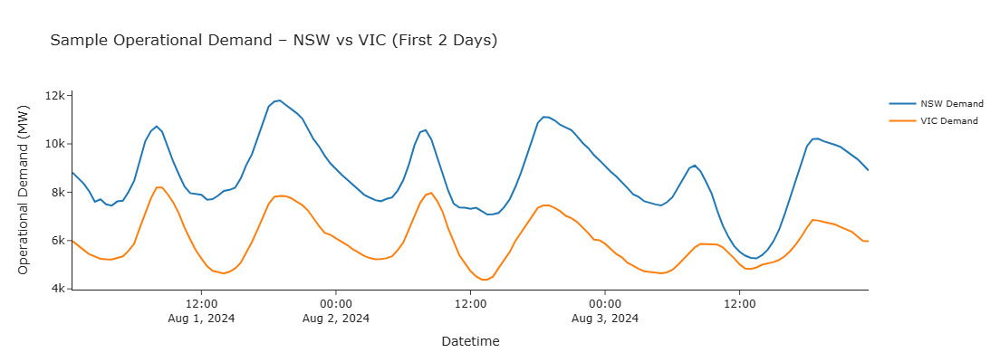

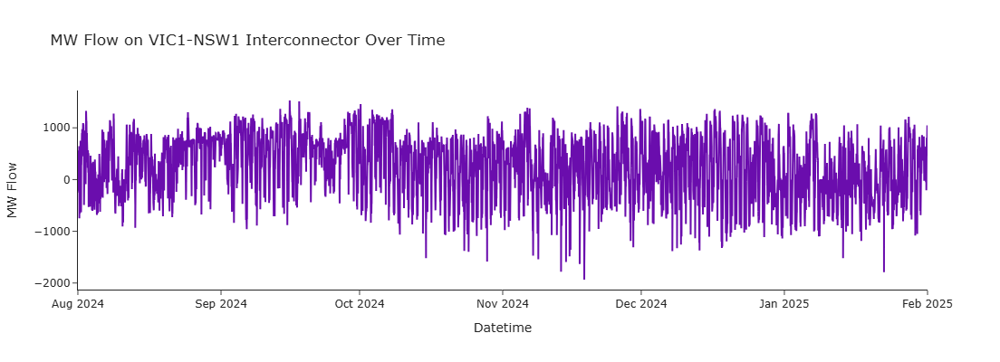

In [69]:
# 2.1 Flow vs Limits  Distribution, Sample Demand Curves, MW Flow Over Time 
# Ensures datetime columns are set as index and sorted for accurate time-series plotting
df_interconnector_vic_nsw = df_interconnector_vic_nsw.copy().set_index('SETTLEMENTDATE').sort_index()
df_demand_nsw = df_demand_nsw.copy().set_index('INTERVAL_DATETIME').sort_index()
df_demand_vic = df_demand_vic.copy().set_index('INTERVAL_DATETIME').sort_index()

# Sample Demand Curves for NSW and VIC (First 2 Days) 
fig2 = go.Figure()
fig2.add_trace(go.Scatter(
    x=df_demand_nsw.loc[:'2024-08-03'].index,
    y=df_demand_nsw.loc[:'2024-08-03', 'OPERATIONAL_DEMAND.1'],
    mode='lines',
    name='NSW Demand',
    line=dict(color='#1f77b4'),
    hovertemplate='Datetime: %{x}<br>NSW Demand: %{y:.1f} MW<extra></extra>'
))
fig2.add_trace(go.Scatter(
    x=df_demand_vic.loc[:'2024-08-03'].index,
    y=df_demand_vic.loc[:'2024-08-03', 'OPERATIONAL_DEMAND.1'],
    mode='lines',
    name='VIC Demand',
    line=dict(color='#ff7f0e'),
    hovertemplate='Datetime: %{x}<br>VIC Demand: %{y:.1f} MW<extra></extra>'
))

fig2.update_layout(
    title='Sample Operational Demand – NSW vs VIC (First 2 Days)',
    xaxis_title='Datetime',
    yaxis_title='Operational Demand (MW)',
    legend=dict(font=dict(size=10)),
    height=400,
    template='simple_white'
)
fig2.show()

# MW Flow Over Time
# This graph observes directional flow trends & power transfer magnitude.
fig3 = go.Figure()
fig3.add_trace(go.Scatter(
    x=df_interconnector_vic_nsw.index,
    y=df_interconnector_vic_nsw['MWFLOW'],
    mode='lines',
    name='MW Flow',
    line=dict(color='#6a0dad'),
    hovertemplate='Datetime: %{x}<br>MW Flow: %{y:.1f}<extra></extra>'
))

fig3.update_layout(
    title='MW Flow on VIC1-NSW1 Interconnector Over Time',
    xaxis_title='Datetime',
    yaxis_title='MW Flow',
    height=400,
    template='simple_white'
)
fig3.show()


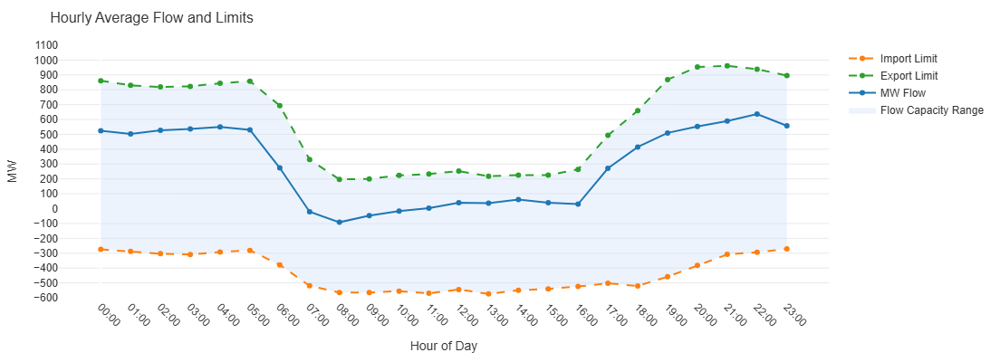

In [71]:
# 2.2 Hourly Average Flow and Limits
# Ensure 'SETTLEMENTDATE' is used as the datetime index
if df_interconnector_vic_nsw.index.name != 'SETTLEMENTDATE':
    df_interconnector_vic_nsw.set_index('SETTLEMENTDATE', inplace=True)

# Extract the hour from the datetime index
df_interconnector_vic_nsw['HOUR'] = df_interconnector_vic_nsw.index.hour

# Compute average MW flow and limits for each hour of the day
avg_hourly = df_interconnector_vic_nsw.groupby('HOUR')[['MWFLOW', 'EXPORTLIMIT', 'IMPORTLIMIT']].mean().reset_index()

# Determines y-axis range for a clean and readable plot
y_min = int(avg_hourly[['MWFLOW', 'EXPORTLIMIT', 'IMPORTLIMIT']].min().min()) // 100 * 100
y_max = int(avg_hourly[['MWFLOW', 'EXPORTLIMIT', 'IMPORTLIMIT']].max().max()) // 100 * 100 + 200

# Create Plotly figure 
fig = go.Figure()

# Add shaded band between EXPORT and IMPORT limits
fig.add_trace(go.Scatter(
    x=avg_hourly['HOUR'],
    y=avg_hourly['EXPORTLIMIT'],
    mode='lines',
    line=dict(width=0),
    showlegend=False,
    hoverinfo='skip'  # No tooltip for upper boundary line
))
fig.add_trace(go.Scatter(
    x=avg_hourly['HOUR'],
    y=avg_hourly['IMPORTLIMIT'],
    fill='tonexty',  # Fills the area between this line and the previous one
    fillcolor='rgba(208, 225, 249, 0.4)',
    mode='lines',
    line=dict(width=0),
    name='Flow Capacity Range',
    hoverinfo='skip'
))

# Add line for average MW Flow
fig.add_trace(go.Scatter(
    x=avg_hourly['HOUR'],
    y=avg_hourly['MWFLOW'],
    mode='lines+markers',
    name='MW Flow',
    line=dict(color='#1f77b4', width=2)
))

# Add dashed lines for average Export and Import Limits
fig.add_trace(go.Scatter(
    x=avg_hourly['HOUR'],
    y=avg_hourly['EXPORTLIMIT'],
    mode='lines+markers',
    name='Export Limit',
    line=dict(color='#2ca02c', dash='dash')
))
fig.add_trace(go.Scatter(
    x=avg_hourly['HOUR'],
    y=avg_hourly['IMPORTLIMIT'],
    mode='lines+markers',
    name='Import Limit',
    line=dict(color='#ff7f0e', dash='dash')
))

# Update layout and styling 
fig.update_layout(
    title='Hourly Average Flow and Limits',
    title_font=dict(size=16, family='Arial', color='#333333'),
    xaxis_title='Hour of Day',
    yaxis_title='MW',
    font=dict(family='Arial', size=12, color='#333333'),
    legend=dict(
        font=dict(family='Arial', size=12, color='#333333'),
        title_font=dict(family='Arial', size=12, color='#333333')
    ),
    xaxis=dict(
        tickmode='array',
        tickvals=list(range(24)),  # Ensures all 24 hours are shown
        ticktext=[f'{h:02d}:00' for h in range(24)],
        tickangle=45,
        tickfont=dict(family='Arial', size=12, color='#333333'),
        showgrid=False
    ),
    yaxis=dict(
        tickmode='linear',
        tick0=y_min,
        dtick=100,
        range=[y_min, y_max],
        tickfont=dict(family='Arial', size=12, color='#333333'),
        showgrid=True,
        gridcolor='lightgray',
        gridwidth=0.5
    ),
    plot_bgcolor='white',
    margin=dict(t=50, b=50, l=60, r=30),
    height=400
)

# Display the plot
fig.show()


 3. CONGESTION DETECTION AND PATTERN ANALYSIS 

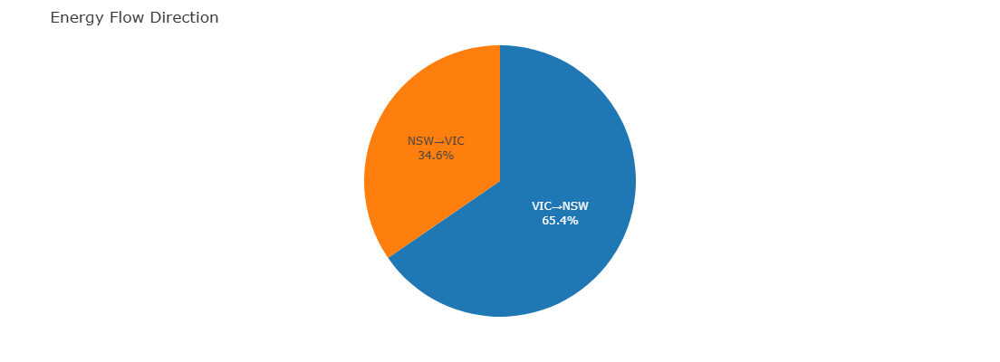

In [73]:
# 3.1 Flow Direction Pie Chart (VIC → NSW or NSW → VIC)

# Determines Flow Direction 
# Positive MWFLOW means energy is flowing from VIC to NSW; negative means NSW to VIC
flow_direction = df_interconnector_vic_nsw['MWFLOW'].apply(lambda x: 'VIC→NSW' if x > 0 else 'NSW→VIC')

# Count the number of occurrences for each direction
count_direction = flow_direction.value_counts()

# Creates interactive pie chart 
fig = go.Figure(data=[go.Pie(
    labels=count_direction.index,        # Flow direction labels
    values=count_direction.values,       # Number of intervals per direction
    marker=dict(colors=['#1f77b4', '#ff7f0e']),  
    textinfo='percent+label',             
    hovertemplate='%{label}: %{value} (%{percent})<extra></extra>',
    sort=False                            
)])

# Layout Styling 
fig.update_layout(
    title='Energy Flow Direction',
    xaxis=dict(tickfont=dict(size=10, color='#333333')),
    yaxis=dict(tickfont=dict(size=10, color='#333333')),
    font=dict(color='#333333'),          
    legend=dict(font=dict(size=10)),
    plot_bgcolor='white',
    height=400,
    margin=dict(t=50, b=50, l=60, r=60),
    showlegend=False                      
)

# Displays
fig.show()


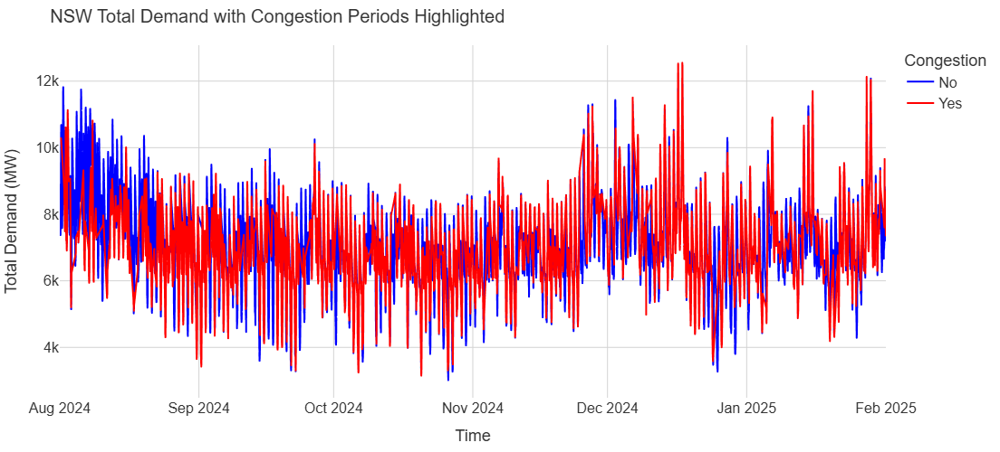

In [75]:
# 3.2 Plot: Total Demand in New South Wales with Highlighted Congestion Periods  

# Fix - Resetting index so that 'SETTLEMENTDATE' becomes a regular column again
df_interconnector_vic_nsw.reset_index(inplace=True)
df_regionsum_nsw.reset_index(inplace=True)

# Recalculating Congestion
# Computing absolute maximum of IMPORT and EXPORT limits to define the flow boundary
df_interconnector_vic_nsw['MWLIMIT'] = df_interconnector_vic_nsw[['EXPORTLIMIT', 'IMPORTLIMIT']].abs().max(axis=1)
df_interconnector_vic_nsw['CONGESTED'] = abs(df_interconnector_vic_nsw['MWFLOW']) >= 0.95 * df_interconnector_vic_nsw['MWLIMIT']   # A time point is congested if the flow is 95% or more of the limit that is available.
# The line below ensures SETTLEMENTDATE columns are in the right format of datetime
df_interconnector_vic_nsw['SETTLEMENTDATE'] = pd.to_datetime(df_interconnector_vic_nsw['SETTLEMENTDATE'])
df_regionsum_nsw['SETTLEMENTDATE'] = pd.to_datetime(df_regionsum_nsw['SETTLEMENTDATE'])

# Combining interconnector congestion status with NSW regionsum
merged = pd.merge(            # Merging them by timestamp to map congestion labels to demand data
    df_regionsum_nsw,
    df_interconnector_vic_nsw[['SETTLEMENTDATE', 'CONGESTED']],
    on='SETTLEMENTDATE',
    how='left'  # Keeping all the demand records
)

# Fill in the NaN (timestamps that don't match) with False (no congestion)
merged['CONGESTED'] = merged['CONGESTED'].fillna(False)

# Creates a readable congestion label for coloring
merged['Congestion Label'] = merged['CONGESTED'].map({True: 'Yes', False: 'No'})

# Plotting the graphs using Plotly Express
fig = px.line(
    merged,
    x='SETTLEMENTDATE',
    y='TOTALDEMAND',
    color='Congestion Label',  # Setting different color of lines for congested and non-congested
    color_discrete_map={'Yes': 'red', 'No': 'blue'},  # Assigning/defining specific colors
    labels={'TOTALDEMAND': 'Total Demand (MW)', 'SETTLEMENTDATE': 'Time'},
    
    hover_data={'TOTALDEMAND': ':.0f', 'SETTLEMENTDATE': True, 'Congestion Label': True}
)

# Styling Layout
fig.update_layout(
    title=dict(
        text='NSW Total Demand with Congestion Periods Highlighted',
        font=dict(family='Arial', size=20, color='#333333')
    ),
    font=dict(family='Arial', size=12, color='#333333'),
    legend=dict(
        title='Congestion',
        title_font=dict(family='Arial', size=18, color='#333333'),
        font=dict(family='Arial', size=16, color='#333333')
    ),
    #Showing the tooltips across x-axis
    hovermode='x unified',  
    plot_bgcolor='white',
    height=500,
    margin=dict(t=50, b=40, l=60, r=30)
)

# Styling X-Axis 
fig.update_xaxes(
    title='Time',
    title_font=dict(family='Arial', size=18, color='#333333'),
    tickfont=dict(family='Arial', size=16, color='#333333'),
    showgrid=True,
    gridcolor='lightgray'
)

# Styling Y-Axis
fig.update_yaxes(
    title='Total Demand (MW)',
    title_font=dict(family='Arial', size=18, color='#333333'),
    tickfont=dict(family='Arial', size=16, color='#333333'),
    showgrid=True,
    gridcolor='lightgray'
)

# Displays plot
fig.show()


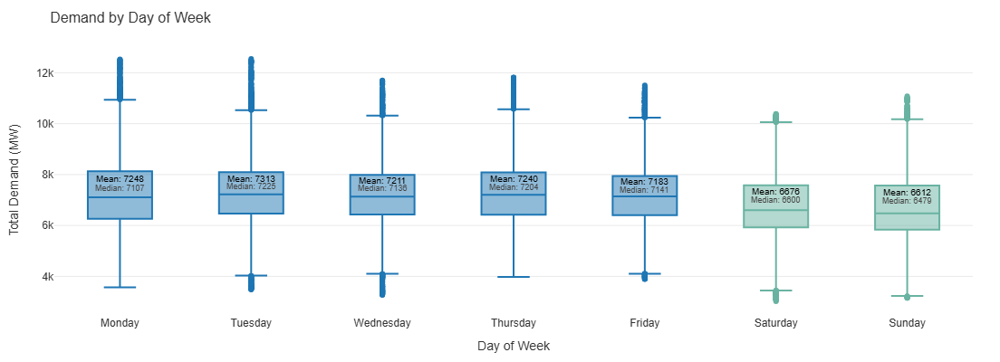

In [77]:
# 3.3 Demand Variability by Day of Week 

# Data Preparation
# Ensures SETTLEMENTDATE is in datetime format
df_regionsum_nsw['SETTLEMENTDATE'] = pd.to_datetime(df_regionsum_nsw['SETTLEMENTDATE'])

# Extract weekday name (e.g., Monday, Tuesday, Wednesday...)
df_regionsum_nsw['WEEKDAY'] = df_regionsum_nsw['SETTLEMENTDATE'].dt.day_name()

# Defines weekday order and color map 
weekday = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
color_map = {
    'Monday': '#1f77b4', 'Tuesday': '#1f77b4', 'Wednesday': '#1f77b4',
    'Thursday': '#1f77b4', 'Friday': '#1f77b4',
    'Saturday': '#69b3a2', 'Sunday': '#69b3a2'
}

# Creates boxplot of TOTALDEMAND by weekday 
fig = px.box(
    df_regionsum_nsw,
    x='WEEKDAY',
    y='TOTALDEMAND',
    color='WEEKDAY',
    category_orders={'WEEKDAY': weekday},     # Ensures consistent order of weekdays
    color_discrete_map=color_map,                   # Use same color for weekdays vs weekends
    points='outliers',                              # Shows individual outliers
    hover_data={'TOTALDEMAND': True, 'WEEKDAY': False}
)

# Annotate Mean & Median for each Day
for i, day in enumerate(weekday):
    group = df_regionsum_nsw[df_regionsum_nsw['WEEKDAY'] == day]['TOTALDEMAND']
    mean_val = group.mean()
    median_val = group.median()
    q1 = group.quantile(0.25)
    q3 = group.quantile(0.75)

    # Positions annotations inside the box 
    mean_y = q3 - (q3 - q1) * 0.15
    median_y = q3 - (q3 - q1) * 0.35

    # Add Mean annotation
    fig.add_annotation(
        x=day, y=mean_y,
        text=f"Mean: {mean_val:.0f}",
        showarrow=False,
        font=dict(size=10, color="black")
    )
    # Add Median annotation
    fig.add_annotation(
        x=day, y=median_y,
        text=f"Median: {median_val:.0f}",
        showarrow=False,
        font=dict(size=9, color="#444444")
    )

# Layout styling
fig.update_layout(
    title='Demand by Day of Week',
    title_font=dict(size=16, family='Arial', color='#333333'),
    xaxis_title='Day of Week',
    yaxis_title='Total Demand (MW)',
    font=dict(family='Arial', size=12, color='#333333'),
    xaxis=dict(
        tickfont=dict(family='Arial', size=12, color='#333333'),
        showgrid=False
    ),
    yaxis=dict(
        tickfont=dict(family='Arial', size=12, color='#333333'),
        showgrid=True,
        gridcolor='lightgray',
        gridwidth=0.5
    ),
    legend=dict(font=dict(family='Arial', size=10, color='#333333')),
    plot_bgcolor='white',
    height=400,
    margin=dict(t=50, b=40, l=60, r=30),
    hovermode='x unified',
    showlegend=False  
)

# Ensures y-axis grid is visible
fig.update_yaxes(showgrid=True, gridcolor='lightgray', gridwidth=0.5)

# Displays
fig.show()


In [79]:
# 3.4 Demand Variability: Congested vs Non-Congested 

# Group by congestion status and compute key demand statistics
# Calculates mean, standard deviation, minimum, and maximum of TOTALDEMAND for both congestion states
summary_variability = merged.groupby('CONGESTED')['TOTALDEMAND'].agg(
    Mean='mean',
    Std_Dev='std',
    Minimum='min',
    Maximum='max'
).round(2)  # Round values to 2 decimal places

# Displays a styled summary table 
styled_summary = (
    summary_variability
    .style
    .set_caption("Table: NSW Total Demand Variability by Congestion Status")  # Table title
    .format("{:.2f}")  # Format all values to 2 decimal places
    .background_gradient(cmap='Blues', axis=1)  # Apply blue gradient by column
    .set_table_styles([  # Customize caption and cell styles
        {'selector': 'caption',
         'props': [('color', '#333'), ('font-size', '12px'), ('font-weight', 'bold'),
                   ('text-align', 'left'), ('padding', '10px 0')]},
        {'selector': 'th',
         'props': [('font-size', '12px'), ('color', '#222'), ('text-align', 'center')]},
        {'selector': 'td',
         'props': [('font-size', '12px'), ('text-align', 'center')]}
    ])
)

# Output
print("\n Demand Variability During Congested vs Non-Congested Periods:")
styled_summary  



 Demand Variability During Congested vs Non-Congested Periods:


,Mean,Std_Dev,Minimum,Maximum
CONGESTED,,,,
False,7108.96,1424.28,3015.86,12504.04
True,7001.55,1369.61,3149.96,12549.72


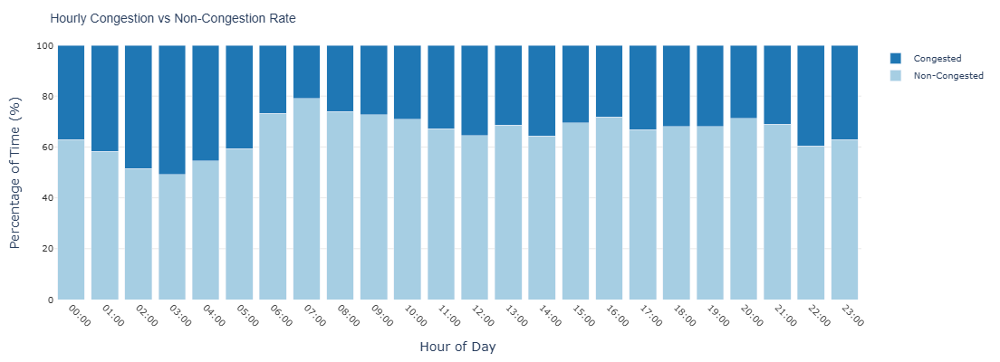

In [81]:
# 3.5 Hourly Congestion Frequency

# Extracts hour from timestamp index
merged['HOUR'] = pd.to_datetime(merged['SETTLEMENTDATE']).dt.hour

# Group by hour and calculate total records and congested counts
counts_hourly = merged.groupby('HOUR')['CONGESTED'].agg(['count', 'sum']).reset_index()
counts_hourly.rename(columns={'count': 'total', 'sum': 'congested'}, inplace=True)

# Calculates non-congested records
counts_hourly['non_congested'] = counts_hourly['total'] - counts_hourly['congested']

# Converts counts to percentages
counts_hourly['congested_pct'] = (counts_hourly['congested'] / counts_hourly['total']) * 100
counts_hourly['non_congested_pct'] = 100 - counts_hourly['congested_pct']

# Creates stacked bar chart 
fig = go.Figure()

# Adds non-congested bars
fig.add_trace(go.Bar(
    x=[f"{h:02d}:00" for h in counts_hourly['HOUR']],  # Format hour as 00:00, 01:00, ...
    y=counts_hourly['non_congested_pct'],
    name='Non-Congested',
    marker_color='#A6CEE3',
    hovertemplate='Hour: %{x}<br>Non-Congested: %{y:.1f}%<extra></extra>'
))

# Adds congested bars stacked on top
fig.add_trace(go.Bar(
    x=[f"{h:02d}:00" for h in counts_hourly['HOUR']],
    y=counts_hourly['congested_pct'],
    name='Congested',
    marker_color='#1f77b4',
    hovertemplate='Hour: %{x}<br>Congested: %{y:.1f}%<extra></extra>'
))

# Customize layout 
fig.update_layout(
    barmode='stack',  # Stack congested over non-congested
    title='Hourly Congestion vs Non-Congestion Rate',
    title_font=dict(size=14, family='Arial'),
    xaxis_title='Hour of Day',
    yaxis_title='Percentage of Time (%)',
    xaxis=dict(
        tickangle=45,
        tickfont=dict(size=10, color='#333333')
    ),
    yaxis=dict(
        tickfont=dict(size=10, color='#333333'),
        tickformat=".0f",
        showgrid=True,
        gridcolor='lightgray',
        gridwidth=0.5,
        range=[0, 100]  # Ensures full 0–100% y-axis scale
    ),
    legend=dict(font=dict(size=10)),
    plot_bgcolor='white',
    margin=dict(t=50, b=50, l=60, r=30),
    height=400
)

# Display plot 
fig.show()


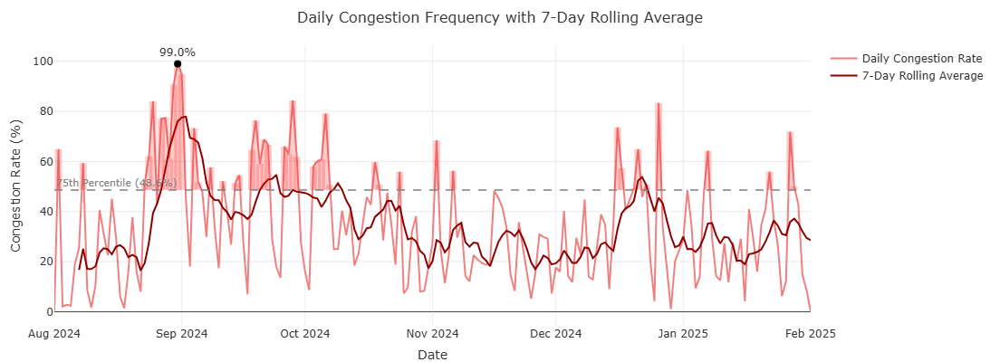

In [83]:
# 3.6 Daily Congestion Frequency + 7-Day Rolling Avg 
# Calculate daily congestion rate (percentage of congested intervals per day) 
congestion_daily = merged.groupby(pd.to_datetime(merged['SETTLEMENTDATE']).dt.date)['CONGESTED'].mean() * 100
congestion_daily.index = pd.to_datetime(congestion_daily.index)  # Ensure proper datetime index

# Calculate 7-day rolling average of congestion rate 
avg_rolling = congestion_daily.rolling(window=7).mean()

# Identify values above 75th percentile threshold 
threshold = congestion_daily.quantile(0.75)  # Threshold for high congestion days
above_threshold = congestion_daily[congestion_daily > threshold]  # Days above threshold

# Identify the highest congestion day for annotation 
highest_date = congestion_daily.idxmax()
highest_value = congestion_daily.max()

# Create interactive Plotly figure 
fig = go.Figure()

# Line plot for daily congestion rate
fig.add_trace(go.Scatter(
    x=congestion_daily.index,
    y=congestion_daily,
    mode='lines',
    name='Daily Congestion Rate',
    line=dict(color='lightcoral'),
    hovertemplate='Date: %{x|%b %d}<br>Congestion: %{y:.1f}%<extra></extra>'
))

# Line plot for 7-day rolling average
fig.add_trace(go.Scatter(
    x=congestion_daily.index,
    y=avg_rolling,
    mode='lines',
    name='7-Day Rolling Average',
    line=dict(color='darkred', width=2),
    hovertemplate='Date: %{x|%b %d}<br>7-Day Avg: %{y:.1f}%<extra></extra>'
))

# Shaded vertical bars for days above threshold
for date, value in above_threshold.items():
    fig.add_trace(go.Scatter(
        x=[date, date],
        y=[threshold, value],
        mode='lines',
        line=dict(color='rgba(255,0,0,0.2)', width=8),
        name='Above 75th Percentile',
        hoverinfo='skip',
        showlegend=False
    ))

# Add a horizontal line at the 75th percentile threshold
fig.add_hline(
    y=threshold,
    line=dict(color='gray', dash='dash', width=1.5),
    annotation_text=f"75th Percentile ({threshold:.1f}%)",
    annotation_position="top left",
    annotation_font=dict(size=11, color="gray")
)

# Highlight the day with the highest congestion rate
fig.add_trace(go.Scatter(
    x=[highest_date],
    y=[highest_value],
    mode='markers+text',
    name='Max Spike',
    marker=dict(color='black', size=8),
    text=[f'{highest_value:.1f}%'],
    textposition='top center',
    showlegend=False
))

# Final layout styling consistent with previous sections
fig.update_layout(
    template=None,
    title_text='Daily Congestion Frequency with 7-Day Rolling Average',
    title_font=dict(size=16, color='#333333'),
    xaxis_title='Date',
    yaxis_title='Congestion Rate (%)',
    xaxis=dict(tickfont=dict(size=12, color='#333333')),
    yaxis=dict(tickfont=dict(size=12, color='#333333')),
    legend=dict(font=dict(size=12, color='#333333')),
    font=dict(color='#333333'),
    plot_bgcolor='white',
    height=400,
    margin=dict(t=50, b=40, l=60, r=30),
    hovermode='x unified'
)

# Add light grid to y-axis
fig.update_yaxes(showgrid=True, gridcolor='lightgray', gridwidth=0.5)

# Show the final interactive figure
fig.show()


In [85]:
# 3.7 Overall Congestion Frequency 

# Calculates the percentage of time intervals where congestion occurred
congestion_percent = merged['CONGESTED'].mean() * 100

# Prints the result with a warning icon and formatted percentage
print(f"Congestion occurred in {congestion_percent:.2f}% of all intervals.")


Congestion occurred in 34.24% of all intervals.


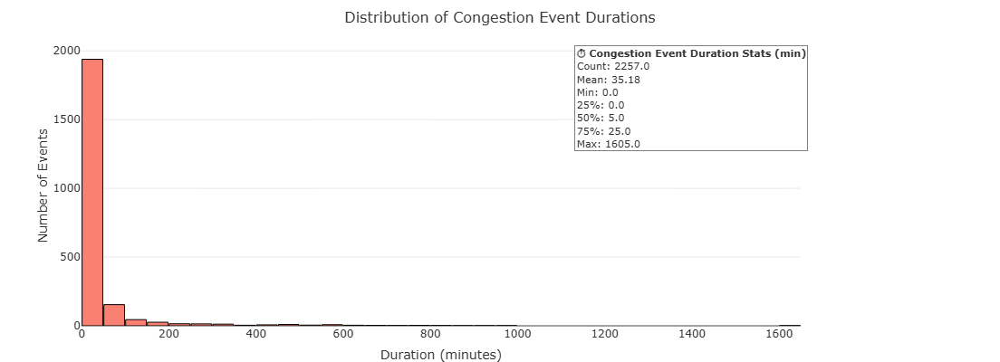

In [87]:
# 3.8 Duration of Congestion Events 

# Setup: Prepares congestion event durations 

# Resetting index to ensure 'SETTLEMENTDATE' is a regular column
df_interconnector_vic_nsw.reset_index(inplace=True)

# Sorts by time to ensure sequential comparison of congestion states
df_interconnector_vic_nsw.sort_values('SETTLEMENTDATE', inplace=True)

# Creates a boolean column to identify when the congestion state changes (True when different from previous row)
df_interconnector_vic_nsw['CONGESTED_SHIFT'] = df_interconnector_vic_nsw['CONGESTED'].ne(
    df_interconnector_vic_nsw['CONGESTED'].shift()
)
# Cumulative sum of shifts creates a unique event ID for each continuous state (congested or not)
df_interconnector_vic_nsw['EVENT_ID'] = df_interconnector_vic_nsw['CONGESTED_SHIFT'].cumsum()
# Filters to retain only congested events (True)
cong_events = df_interconnector_vic_nsw[df_interconnector_vic_nsw['CONGESTED'] == True]

# Group by each congestion event and get the start and end timestamps
durations_event= cong_events.groupby('EVENT_ID')['SETTLEMENTDATE'].agg(['min', 'max'])

# Calculates event duration in minutes
durations_event['DURATION_MINUTES'] = (durations_event['max'] - durations_event['min']).dt.total_seconds() / 60

# Summary stats (rounded) 
# Gets descriptive statistics (count, mean, min, quartiles, max) for duration
stats = durations_event['DURATION_MINUTES'].describe().round(2)

# Formats the stats as a string to show inside the plot
stats_text = (
    f"<b>⏱ Congestion Event Duration Stats (min)</b><br>"
    f"Count: {stats['count']}<br>"
    f"Mean: {stats['mean']}<br>"
    f"Min: {stats['min']}<br>"
    f"25%: {stats['25%']}<br>"
    f"50%: {stats['50%']}<br>"
    f"75%: {stats['75%']}<br>"
    f"Max: {stats['max']}"
)

# Plotly histogram 
# Creates histogram to show distribution of congestion event durations
fig = go.Figure()

fig.add_trace(go.Histogram(
    x=durations_event['DURATION_MINUTES'],  # Duration values on x-axis
    nbinsx=50,  # Number of histogram bins
    marker=dict(color='salmon', line=dict(color='black', width=1)),  
    hovertemplate='Duration: %{x:.0f} min<br>Count: %{y}<extra></extra>',  
    name='Event Duration'
))

# Stats box as annotation 
# Adds a floating annotation box showing summary stats
fig.add_annotation(
    xref="paper", yref="paper",  
    x=1.01, y=1,  
    text=stats_text,  
    align='left',
    showarrow=False,
    bordercolor='gray',
    borderwidth=1,
    bgcolor='white',  
    font=dict(size=11, color='#333333'),
)

# Layout styling 

fig.update_layout(
    template=None,
    title_text='Distribution of Congestion Event Durations',
    title_font=dict(size=16, color='#333333'),  # Title styling
    xaxis_title='Duration (minutes)',
    yaxis_title='Number of Events',
    xaxis=dict(tickfont=dict(size=12, color='#333333')),
    yaxis=dict(tickfont=dict(size=12, color='#333333')),
    legend=dict(font=dict(size=10, color='#333333')),
    font=dict(color='#333333'),
    plot_bgcolor='white',
    height=400,
    margin=dict(t=50, b=40, l=90, r=220),  
    bargap=0.05  
)

# Adding gridlines for better readability
fig.update_yaxes(showgrid=True, gridcolor='lightgray', gridwidth=0.5)

# Shows
fig.show()


4 Price Impact Analysis 

In [89]:
# 4.1 Loads and Clean Price Data

# Defines the path to the raw input price files
price_input_path = os.path.join(base_dir, 'datasets', 'price')
price_cleaned_path = os.path.join(base_dir, 'datasets_cleaned', 'price_cleaned')

# Ensures the output folder for cleaned files exists (create if missing)
os.makedirs(price_cleaned_path, exist_ok=True)

# Loops through all folders and files in the price input directory
for root, dirs, files in os.walk(price_input_path):
    for filename in files:
        # Processes only CSV files
        if filename.lower().endswith('.csv'):
            file_path = os.path.join(root, filename)  # Full path to the file

            try:
                # Open and read all lines of the file
                with open(file_path, 'r', encoding='utf-8') as f:
                    lines = f.readlines()

                # Trys to detect the header row by looking for key column names
                header_line_index = next(
                    (i for i, line in enumerate(lines) if 'SETTLEMENTDATE' in line and ('REGIONID' in line or 'RRP' in line)),
                    None
                )

                # Skipping file if no valid header is found
                if header_line_index is None:
                    print(f"Skipped {filename} — Header not found.")
                    continue

                # Reads the CSV starting from the detected header line
                df = pd.read_csv(file_path, skiprows=header_line_index)

                # Drops the first 4 columns (junk or metadata columns)
                df = df.iloc[:, 4:]

                # Converts 'SETTLEMENTDATE' column to datetime format
                if 'SETTLEMENTDATE' in df.columns:
                    df['SETTLEMENTDATE'] = pd.to_datetime(df['SETTLEMENTDATE'], errors='coerce')

                # Drops any columns that are completely empty
                df.dropna(axis=1, how='all', inplace=True)

                # Fill in partially missing values depending on data type
                for col in df.columns:
                    if df[col].isnull().any():
                        if df[col].dtype in ['float64', 'int64']:
                            # Fill in numeric columns with their mean
                            df[col] = df[col].fillna(df[col].mean())
                        elif df[col].dtype == 'object':
                            # Fill in string columns with "Unknown"
                            df[col] = df[col].fillna('Unknown')

                # Keeps only records for VIC1 and NSW1 regions
                if 'REGIONID' in df.columns:
                    df = df[df['REGIONID'].isin(['VIC1', 'NSW1'])]

                # Resets the index after filtering
                df.reset_index(drop=True, inplace=True)

                # Creates a cleaned file name and save the result
                cleaned_filename = f"cleaned_{filename}"
                cleaned_path = os.path.join(price_cleaned_path, cleaned_filename)
                df.to_csv(cleaned_path, index=False)
                print(f"Cleaned file saved: {cleaned_filename}")

            except Exception as e:
                # Handle any exceptions during processing
                print(f"Error processing {filename}: {e}")


Cleaned file saved: cleaned_PUBLIC_ARCHIVE#DISPATCHPRICE#FILE01#202408010000.CSV
Cleaned file saved: cleaned_PUBLIC_ARCHIVE#DISPATCHPRICE#FILE01#202409010000.CSV
Cleaned file saved: cleaned_PUBLIC_ARCHIVE#DISPATCHPRICE#FILE01#202410010000.CSV
Cleaned file saved: cleaned_PUBLIC_ARCHIVE#DISPATCHPRICE#FILE01#202411010000.CSV
Cleaned file saved: cleaned_PUBLIC_ARCHIVE#DISPATCHPRICE#FILE01#202412010000.CSV
Cleaned file saved: cleaned_PUBLIC_ARCHIVE#DISPATCHPRICE#FILE01#202501010000.CSV



--- Analysis for NSW1 ---


C:\Users\Dell\AppData\Local\Temp\ipykernel_17448\2745192862.py:38: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




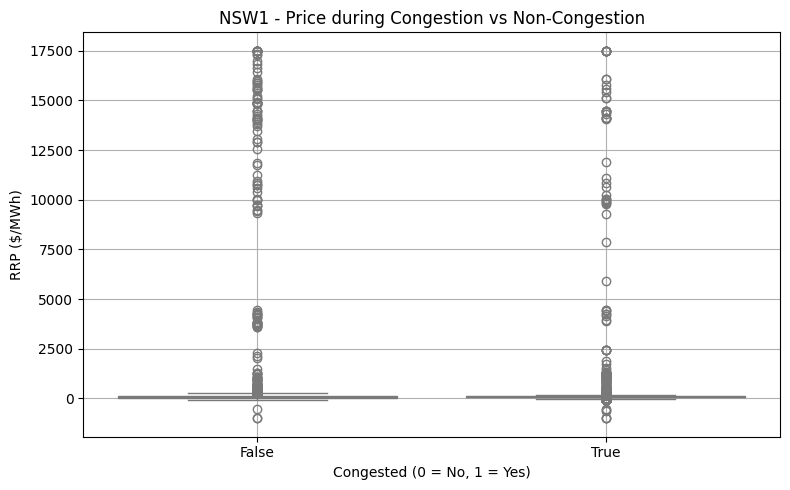

NSW1 Regression: RRP = 131.33 + -20.02 * Congested


C:\Users\Dell\AppData\Roaming\Python\Python312\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but LinearRegression was fitted with feature names



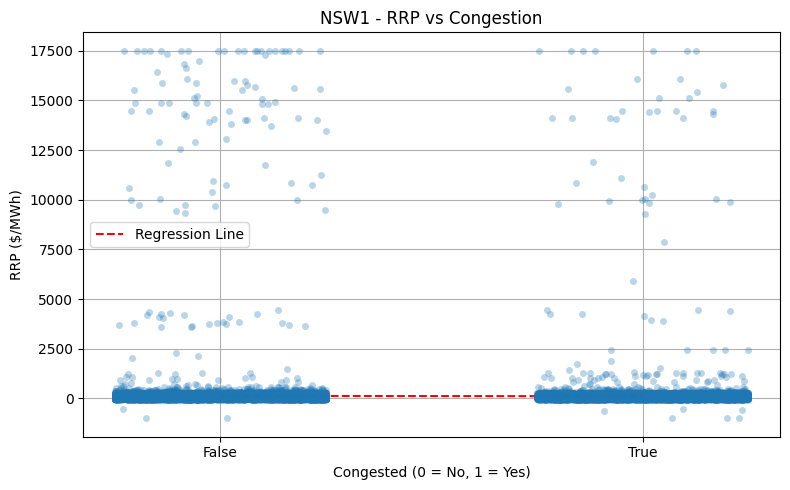


--- Analysis for VIC1 ---


C:\Users\Dell\AppData\Local\Temp\ipykernel_17448\2745192862.py:38: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




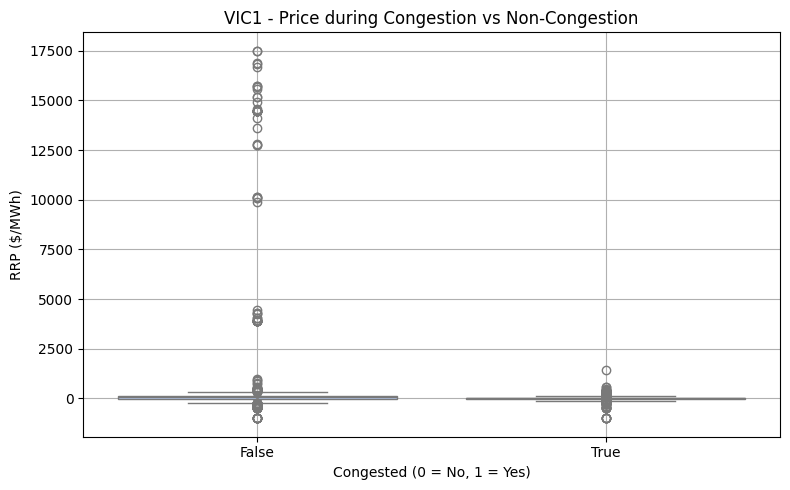

VIC1 Regression: RRP = 80.62 + -66.74 * Congested


C:\Users\Dell\AppData\Roaming\Python\Python312\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but LinearRegression was fitted with feature names



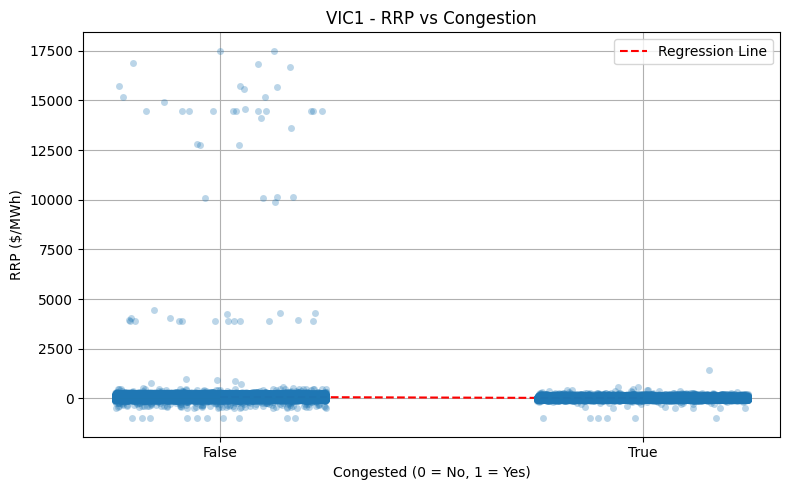


--- Analysis for Combined VIC+NSW ---


C:\Users\Dell\AppData\Local\Temp\ipykernel_17448\2745192862.py:38: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




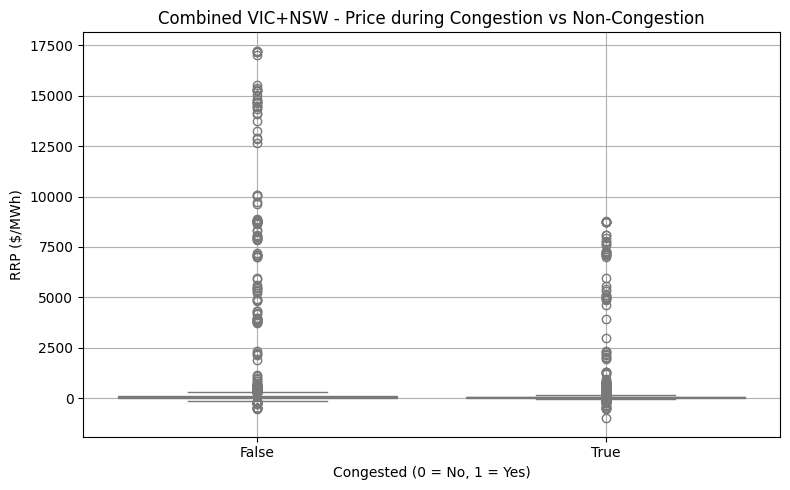

Combined VIC+NSW Regression: RRP = 105.98 + -43.38 * Congested


C:\Users\Dell\AppData\Roaming\Python\Python312\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but LinearRegression was fitted with feature names



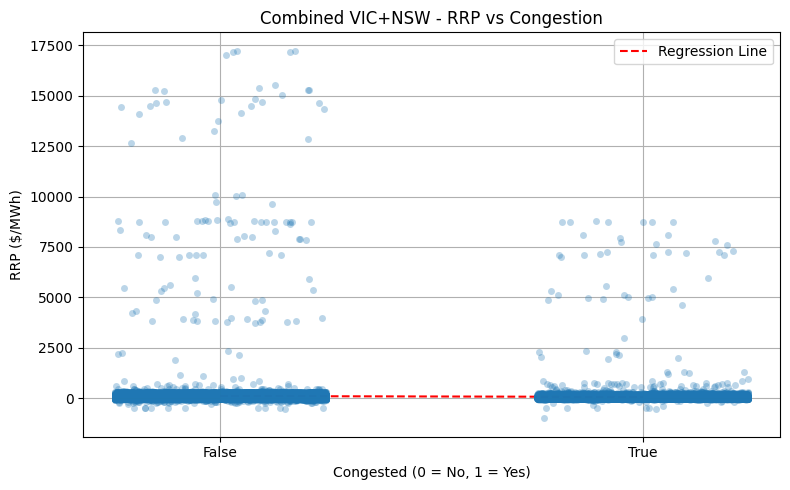

In [91]:
# 4.2 Congestion vs Price Comparison (NSW, VIC, Combined)

import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression

# Load cleaned price data from folder 
cleaned_price_path = os.path.join(base_dir, 'datasets_cleaned', 'price_cleaned')

# Collects all CSV files in the directory (case-insensitive)
price_files = [f for f in os.listdir(cleaned_price_path) if f.lower().endswith('.csv')]

# Read all price CSVs and combine into a single DataFrame
price_df = pd.concat([
    pd.read_csv(os.path.join(cleaned_price_path, file), parse_dates=['SETTLEMENTDATE'])
    for file in price_files
], ignore_index=True)

# Prepares congestion data from VIC–NSW interconnector 
data_congestion = df_interconnector_vic_nsw[['SETTLEMENTDATE', 'CONGESTED']].copy()

df_interconnector_vic_nsw.set_index('SETTLEMENTDATE', inplace=True)

# Perform analysis of congestion vs price 
def run_price_congestion_analysis(region_name, price_df, congestion_df):
    print(f"\n--- Analysis for {region_name} ---")
    
    # Merging price and congestion data on timestamp
    merged = pd.merge(price_df, congestion_df, on='SETTLEMENTDATE', how='inner')

    # Keeps only relevant columns and drop any rows with missing values
    merged_clean = merged[['CONGESTED', 'RRP']].dropna()

    # Boxplot: RRP by Congestion Status
    plt.figure(figsize=(8, 5))
    sns.boxplot(x='CONGESTED', y='RRP', data=merged_clean, palette='coolwarm')
    plt.title(f'{region_name} - Price during Congestion vs Non-Congestion')
    plt.xlabel('Congested (0 = No, 1 = Yes)')
    plt.ylabel('RRP ($/MWh)')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Linear Regression: Price explained by congestion 
    X = merged_clean[['CONGESTED']].astype(int)  # Congestion as numeric input
    y = merged_clean['RRP']  # Response variable: RRP
    model = LinearRegression()
    model.fit(X, y)
    
    # Prints the regression equation
    print(f"{region_name} Regression: RRP = {model.intercept_:.2f} + {model.coef_[0]:.2f} * Congested")

    # Scattering plot with regression line 
    plt.figure(figsize=(8, 5))
    sns.stripplot(x='CONGESTED', y='RRP', data=merged_clean, jitter=0.25, alpha=0.3)
    plt.plot([0, 1], model.predict([[0], [1]]), color='red', linestyle='--', label='Regression Line')
    plt.title(f'{region_name} - RRP vs Congestion')
    plt.xlabel('Congested (0 = No, 1 = Yes)')
    plt.ylabel('RRP ($/MWh)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Run analysis for each region

# NSW1: Filter for NSW records and run analysis
df_nsw_price = price_df[price_df['REGIONID'] == 'NSW1'][['SETTLEMENTDATE', 'RRP']]
run_price_congestion_analysis("NSW1", df_nsw_price, data_congestion)

# VIC1: Filter for VIC records and run analysis
df_vic_price = price_df[price_df['REGIONID'] == 'VIC1'][['SETTLEMENTDATE', 'RRP']]
run_price_congestion_analysis("VIC1", df_vic_price, data_congestion)

# Combined: Average RRP across NSW and VIC, then run analysis 
df_combined_price = price_df[price_df['REGIONID'].isin(['VIC1', 'NSW1'])]

# Averages RRP for each timestamp across both regions
df_combined_price = df_combined_price.groupby('SETTLEMENTDATE', as_index=False)['RRP'].mean()

# Runs combined region analysis
run_price_congestion_analysis("Combined VIC+NSW", df_combined_price, data_congestion)


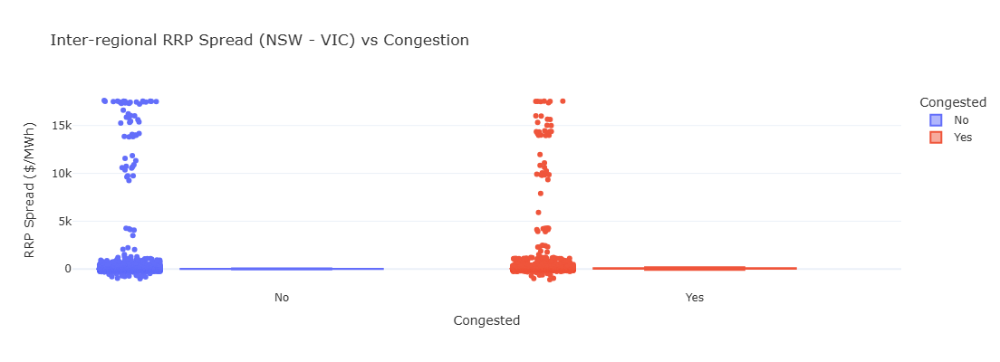

In [93]:
# 4.3 Inter-regional Price Spread

# Ensures SETTLEMENTDATE is available as a column (not index) for merging
df_nsw_price.reset_index(drop=False, inplace=True)
df_vic_price.reset_index(drop=False, inplace=True)

# Merging NSW and VIC RRP data on SETTLEMENTDATE 
df_spread= pd.merge(
    df_nsw_price[['SETTLEMENTDATE', 'RRP']].rename(columns={'RRP': 'NSW_RRP'}),  # Rename for clarity
    df_vic_price[['SETTLEMENTDATE', 'RRP']].rename(columns={'RRP': 'VIC_RRP'}),
    on='SETTLEMENTDATE',
    how='inner'  # Keep only matching timestamps
)

# Calculates price spread (difference between NSW and VIC RRPs)
df_spread['SPREAD'] = df_spread['NSW_RRP'] - df_spread['VIC_RRP']

# Merges congestion status based on SETTLEMENTDATE
df_spread = pd.merge(
    df_spread,
    df_interconnector_vic_nsw.reset_index()[['SETTLEMENTDATE', 'CONGESTED']],  # Get congestion info
    on='SETTLEMENTDATE',
    how='left'
)

# Drop rows where spread or congestion info is missing
df_spread.dropna(subset=['SPREAD', 'CONGESTED'], inplace=True)

# Converts boolean to readable category for plottin
df_spread['Congested'] = df_spread['CONGESTED'].map({True: 'Yes', False: 'No'})

# Creates an interactive box plot using Plotly Express
fig = px.box(
    df_spread,
    x='Congested',  # Split box plot by congestion status
    y='SPREAD',     # Plot spread as Y variable
    color='Congested',  # Color by congestion
    points='all',   # Show all individual points
    hover_data={    # Hover info for exploration
        'SETTLEMENTDATE': True,
        'SPREAD': ':.2f',
        'NSW_RRP': ':.2f',
        'VIC_RRP': ':.2f'
    },
    title='Inter-regional RRP Spread (NSW - VIC) vs Congestion',
    labels={'SPREAD': 'RRP Spread ($/MWh)', 'Congested': 'Congested'}  # Axis labels
)

# Applying consistent layout styling
fig.update_layout(
    template='plotly_white',  
    height=400,               
    font=dict(size=12, color='#333333')  # Font styling
)

# Shows the interactive visualization
fig.show()


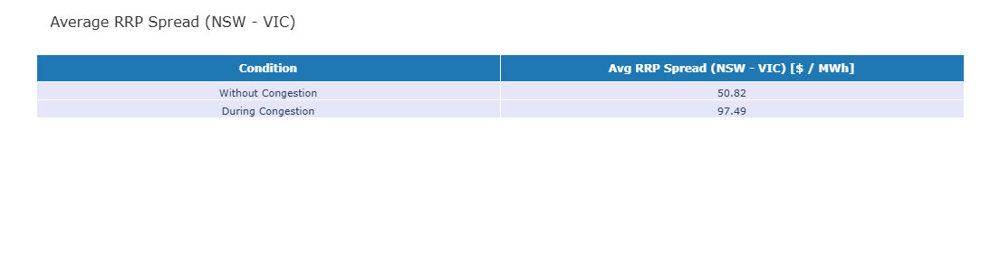

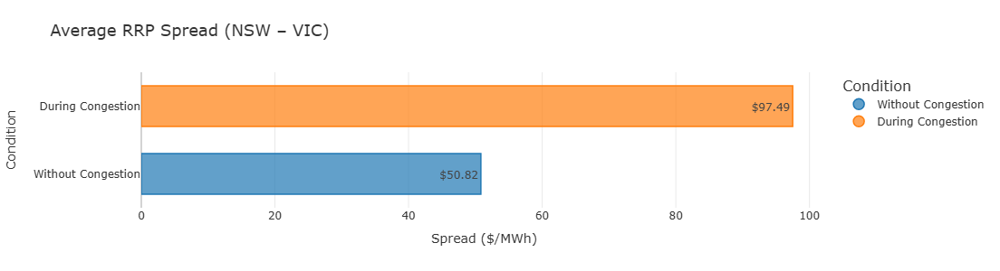

In [95]:
# 4.4 Average RRP Spread (NSW - VIC) 

# Step 1: Ensures 'CONGESTED' column is boolean 
df_spread['CONGESTED'] = df_spread['CONGESTED'].astype(bool)  # Converts True/False to proper boolean type

# Step 2: Calculates average RRP spread for each congestion condition 
spread_avg = df_spread.groupby('CONGESTED')['SPREAD'].mean().round(2).reset_index()  # Group and average SPREAD
spread_avg['CONGESTED'] = spread_avg['CONGESTED'].map({True: 'During Congestion', False: 'Without Congestion'})  # Rename values for readability
spread_avg.rename(columns={'CONGESTED': 'Condition', 'SPREAD': 'Avg RRP Spread (NSW - VIC) [$ / MWh]'}, inplace=True)  # Rename columns

# Creates a styled Plotly table displaying average spreads
fig_table = go.Figure(data=[go.Table(
    header=dict(
        values=['<b>' + col + '</b>' for col in spread_avg.columns],  # Bold column headers
        fill_color='#1f77b4',  # Header background color
        font=dict(color='white', size=12),  # Header font style
        align='center'  # Center align text
    ),
    cells=dict(
        values=[spread_avg[col] for col in spread_avg.columns],  # Table cell values
        fill_color='lavender',  # Cell background color
        font=dict(size=11),  # Font size for cells
        align='center'  # Center align cells
    )
)])

fig_table.update_layout(
    title='Average RRP Spread (NSW - VIC)',  # Table title
    title_font=dict(size=16, color='#333333'),  # Title font style
    margin=dict(t=60, b=20, l=40, r=40),  # Padding around table
    height=300  # Height of the table
)

fig_table.show()  # Show the table

# Horizontal Bar Chart View

# Creates a bar chart figure
fig_bar = go.Figure()

# Adding horizontal bars representing average spread
fig_bar.add_trace(go.Bar(
    x=spread_avg['Avg RRP Spread (NSW - VIC) [$ / MWh]'],  
    y=spread_avg['Condition'],  
    orientation='h',  
    text=[f"${v:.2f}" for v in spread_avg['Avg RRP Spread (NSW - VIC) [$ / MWh]']],  
    textposition='auto',  # Automatically position text
    marker=dict(
        color=[  # Conditional coloring of bars
            'rgba(255,127,14,0.7)' if cond == 'During Congestion' else 'rgba(31,119,180,0.7)'
            for cond in spread_avg['Condition']
        ],
        line=dict(  # Outline for each bar
            color=['#ff7f0e' if cond == 'During Congestion' else '#1f77b4'
                   for cond in spread_avg['Condition']],
            width=1.5
        )
    ),
    hovertemplate='<b>%{y}</b><br>Avg Spread: %{x:.2f} $/MWh<extra></extra>',  # Custom tooltip
    showlegend=False  
))

fig_bar.add_trace(go.Scatter(
    x=[None], y=[None], 
    mode='markers',  
    marker=dict(size=12, color='rgba(31,119,180,0.7)', line=dict(color='#1f77b4', width=1.5)),
    name='Without Congestion',
    hoverinfo='skip',
    showlegend=True
))

fig_bar.add_trace(go.Scatter(
    x=[None], y=[None],
    mode='markers',
    marker=dict(size=12, color='rgba(255,127,14,0.7)', line=dict(color='#ff7f0e', width=1.5)),
    name='During Congestion',
    hoverinfo='skip',
    showlegend=True
))

# Layout styling for bar chart
fig_bar.update_layout(
    title='Average RRP Spread (NSW – VIC)',  # Chart title
    title_font=dict(size=18, color='#333333'),
    xaxis_title='Spread ($/MWh)',  # X-axis label
    yaxis_title='Condition',  # Y-axis label
    xaxis=dict(
        title_font=dict(size=14, color='#333333'),
        tickfont=dict(size=12, color='#333333'),
        showgrid=True, gridcolor='lightgray', gridwidth=0.5,
        zeroline=True, zerolinecolor='lightgray'  # Show zero-line
    ),
    yaxis=dict(
        title_font=dict(size=14, color='#333333'),
        tickfont=dict(size=12, color='#333333'),
        automargin=True  # Avoid cutting off labels
    ),
    font=dict(color='#333333'),
    plot_bgcolor='white',
    margin=dict(t=80, b=70, l=100, r=100),  # Padding
    height=300,
    bargap=0.4,  # Space between bars
    legend=dict(
        title='Condition',
        font=dict(size=12, color='#333333'),
        title_font=dict(size=16, color='#333333')
    )
)

fig_bar.show()  # Shows the bar chart


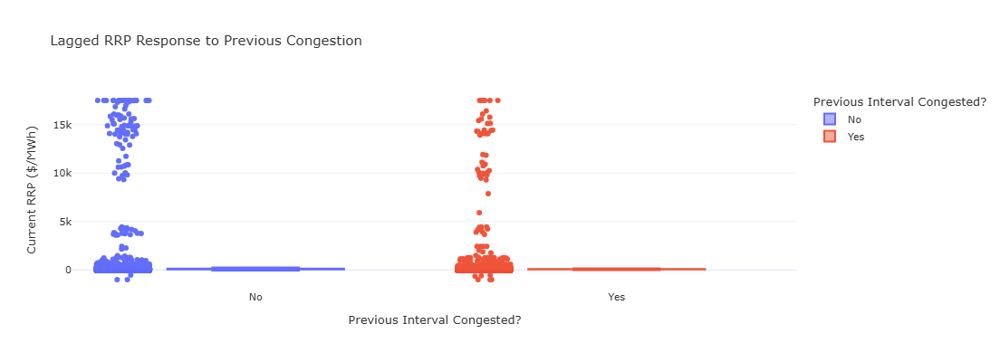

In [97]:
# 4.5 Lagged Price Response
# Ensures SETTLEMENTDATE is a regular column (not index) before setting it again
if df_interconnector_vic_nsw.index.name == 'SETTLEMENTDATE':
    df_interconnector_vic_nsw.reset_index(inplace=True)
if df_nsw_price.index.name == 'SETTLEMENTDATE':
    df_nsw_price.reset_index(inplace=True)

# Set SETTLEMENTDATE as index for both DataFrames for time-based alignment
df_interconnector_vic_nsw.set_index('SETTLEMENTDATE', inplace=True)
df_nsw_price.set_index('SETTLEMENTDATE', inplace=True)

# Creates a lagged congestion column (CONGESTED status from previous interval)
lag_df = df_interconnector_vic_nsw[['CONGESTED']].shift(1)

# Joins lagged congestion with current RRP (spot price)
response_lagged = lag_df.join(df_nsw_price[['RRP']]).dropna()  # Drop any rows with missing values

# Mapping Boolean congestion values to human-readable labels for plotting
response_lagged['Previous Congested'] = response_lagged['CONGESTED'].map({True: 'Yes', False: 'No'})

# Resetting index to make SETTLEMENTDATE a column again for visualization
response_lagged = response_lagged.reset_index()

# Creates interactive boxplot comparing RRP based on previous interval's congestion
fig = px.box(
    response_lagged,
    x='Previous Congested',             # Grouping variable on x-axis
    y='RRP',                            # Current price on y-axis
    color='Previous Congested',         # Color based on congestion status
    points='all',                       # Show all individual points
    hover_data={                        # Tooltip customization
        'SETTLEMENTDATE': True,
        'RRP': ':.2f',
        'Previous Congested': False    
    },
    title='Lagged RRP Response to Previous Congestion',
    labels={'RRP': 'Current RRP ($/MWh)', 'Previous Congested': 'Previous Interval Congested?'}
)

# Aesthetic layout settings
fig.update_layout(
    template='plotly_white',
    height=400,
    font=dict(size=11, color='#333333')
)

# Displays the plot
fig.show()


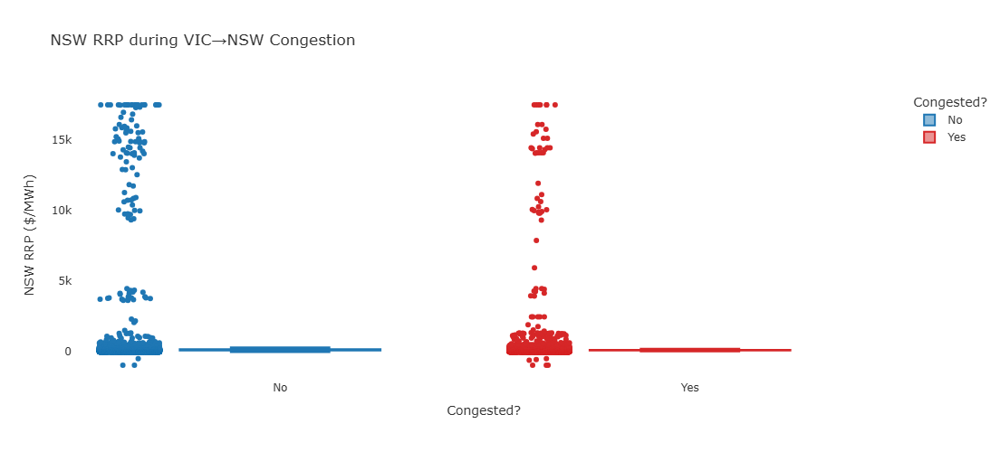

In [99]:
# 4.6 Cross-Region Spillover Effect

# Merge VIC→NSW congestion data with NSW RRP
df_spillover= pd.merge(
    df_interconnector_vic_nsw[['CONGESTED']],  
    df_nsw_price[['RRP']],                     
    left_index=True,                           # Join on index (SETTLEMENTDATE)
    right_index=True,
    how='inner'                                # Keeping only matching timestamps
).dropna()                                     # Drops rows with missing values

# Converting boolean congestion to 'Yes'/'No' strings for plotting labels
df_spillover['CONGESTED_LABEL'] = df_spillover['CONGESTED'].map({False: 'No', True: 'Yes'})

# Creates interactive boxplot comparing NSW prices during congestion vs no congestion
fig = px.box(
    df_spillover,
    x='CONGESTED_LABEL',                       # X-axis: Congested or not
    y='RRP',                                   # Y-axis: NSW Regional Reference Price
    color='CONGESTED_LABEL',                   # Color by congestion status
    color_discrete_map={'No': '#1f77b4', 'Yes': '#d62728'},  # Set custom colors
    category_orders={'CONGESTED_LABEL': ['No', 'Yes']},      
    labels={'CONGESTED_LABEL': 'Congested?', 'RRP': 'NSW RRP ($/MWh)'},  # Axis labels
    title='NSW RRP during VIC→NSW Congestion',
    points='all',                             
    hover_data={'CONGESTED_LABEL': True, 'RRP': ':.2f'}  # Customize hover tooltip
)

# Customizing layout and appearance
fig.update_layout(
    xaxis=dict(
        tickmode='array',
        tickvals=['No', 'Yes'],
        ticktext=['No', 'Yes']                 # Explicit labels for x-axis
    ),
    font=dict(color='#333333'),                # Text color
    plot_bgcolor='white',                      # White background
    hovermode='closest',                       # Hover nearest point
    height=500                                 # Set chart height
)

# Shows the figure
fig.show()


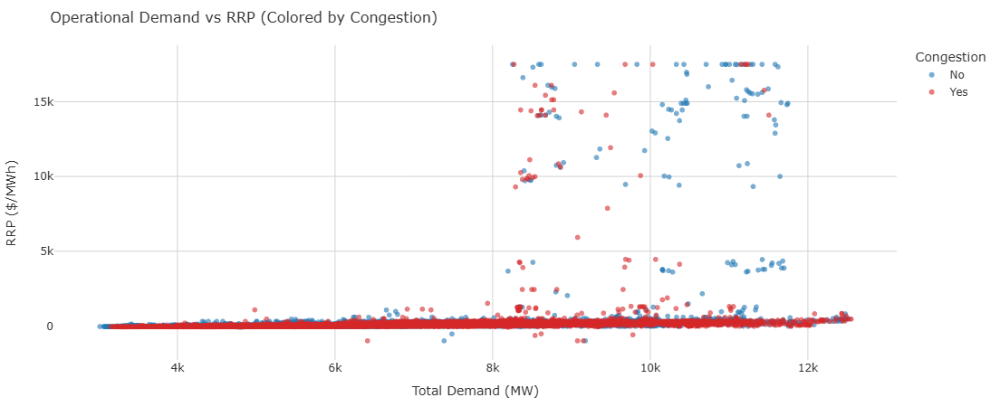

In [103]:
# 4.7 Demand vs Price by Congestion Status 

# Ensures 'RRP' column is in merged dataframe
if 'RRP' not in merged.columns:
    # If RRP is missing, join from df_price_nsw using SETTLEMENTDATE
    merged = merged.join(df_nsw_price[['RRP']], on='SETTLEMENTDATE', how='left')

# Prepares data for plotting
df_plot = merged[['TOTALDEMAND', 'RRP', 'CONGESTED']].dropna().copy()  # Keeping only required columns and drop the rows with NaNs
df_plot['CONGESTED'] = df_plot['CONGESTED'].astype(bool)               # Ensures boolean type
df_plot['Congestion Label'] = df_plot['CONGESTED'].map({True: 'Yes', False: 'No'})  # Creates readable label for plotting

# Creates interactive scatter plot
fig = px.scatter(
    df_plot,
    x='TOTALDEMAND',                            # X-axis: operational demand
    y='RRP',                                     # Y-axis: spot price
    color='Congestion Label',                    
    color_discrete_map={'Yes': '#d62728', 'No': '#1f77b4'},  # Custom colors
    opacity=0.6,                                 # Slight transparency for overlapping points
    labels={
        'TOTALDEMAND': 'Total Demand (MW)',
        'RRP': 'RRP ($/MWh)',
        'Congestion Label': 'Congestion'
    },
    title='Operational Demand vs RRP (Colored by Congestion)',
    hover_data={'TOTALDEMAND': ':.0f', 'RRP': ':.2f'}  # Format tooltips
)

# Updates layout for styling
fig.update_layout(
    title_font=dict(size=16, color='#333333'),
    xaxis=dict(tickfont=dict(size=12, color='#333333')),  # X-axis font styling
    yaxis=dict(tickfont=dict(size=12, color='#333333')),  # Y-axis font styling
    font=dict(color='#333333'),                            # Global font color
    plot_bgcolor='white',                                  # White background
    height=450,
    margin=dict(t=50, b=40, l=60, r=30),                   # Padding
    hovermode='closest',                                   
    legend=dict(font=dict(size=12))                        # Legend font
)

# Adds gridlines for clarity 
fig.update_xaxes(showgrid=True, gridcolor='lightgray')
fig.update_yaxes(showgrid=True, gridcolor='lightgray')

# Displays the figure
fig.show()


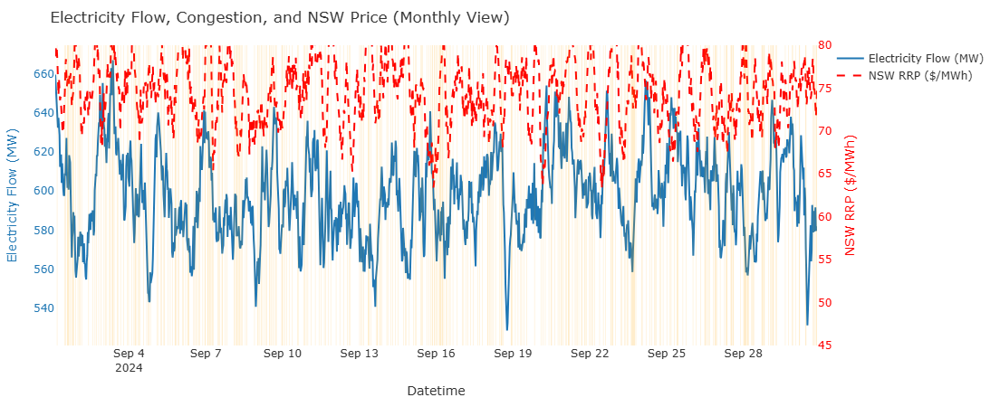

In [105]:
# 4.8 Simulated Visualization: Electricity Flow, Congestion, and NSW Price

# Simulates NSW data 
np.random.seed(0)  # Set seed for reproducibility

# Creates a date range with 30-minute intervals for the month of September 2024
range_date = pd.date_range(start="2024-09-01", end="2024-09-30 23:30", freq="30min")

# Creates a DataFrame with simulated values for electricity flow, RRP, and congestion status
df_nsw_combined = pd.DataFrame({
    'MWFLOW': np.random.normal(loc=600, scale=80, size=len(range_date)),       # Simulated electricity flow (MW)
    'NSW_RRP': np.random.normal(loc=75, scale=15, size=len(range_date)),       # Simulated NSW RRP ($/MWh)
    'CONGESTED': np.random.choice([True, False], size=len(range_date), p=[0.25, 0.75])  # Random congestion status (25% chance)
}, index=range_date)  

# Smooth values using rolling average
df_nsw_combined['MWFLOW_SMOOTH'] = df_nsw_combined['MWFLOW'].rolling(window=12, center=True).mean()  # Smooth MWFLOW over 6-hour window
df_nsw_combined['RRP_SMOOTH'] = df_nsw_combined['NSW_RRP'].rolling(window=12, center=True).mean()    # Smooth NSW_RRP similarly
df_nsw_combined.dropna(inplace=True)  # Drop rows with NaN introduced by rolling mean

# Detecting congestion time intervals for shading
congestion_bands = []  # Storing (start, end) tuples for congestion bands
in_congestion = False  # Flag to track if currently inside a congestion period

# Looping through all time points
for i in range(len(df_nsw_combined)):
    if df_nsw_combined['CONGESTED'].iloc[i] and not in_congestion:
        start = df_nsw_combined.index[i] 
        in_congestion = True
    elif not df_nsw_combined['CONGESTED'].iloc[i] and in_congestion:
        end = df_nsw_combined.index[i]  
        congestion_bands.append((start, end))  
        in_congestion = False

if in_congestion:
    congestion_bands.append((start, df_nsw_combined.index[-1]))

# Creates interactive Plotly figure
fig = go.Figure()

# Adding shaded vertical rectangles for each congestion period
for start, end in congestion_bands:
    fig.add_vrect(x0=start, x1=end, fillcolor='orange', opacity=0.2, line_width=0)  # Add translucent orange band

# Plots smoothed electricity flow (left Y-axis) 
fig.add_trace(go.Scatter(
    x=df_nsw_combined.index,  # X-axis: time
    y=df_nsw_combined['MWFLOW_SMOOTH'],  # Y-axis: smoothed electricity flow
    name='Electricity Flow (MW)',  # Legend name
    line=dict(color='#1f77b4'),  # Line color: blue
    hovertemplate='Time: %{x}<br>Flow: %{y:.1f} MW<extra></extra>',  # Custom hover text
    yaxis='y1'  # Use first Y-axis
))

# Plots smoothed NSW RRP (right Y-axis) 
fig.add_trace(go.Scatter(
    x=df_nsw_combined.index,  # X-axis: time
    y=df_nsw_combined['RRP_SMOOTH'],  # Y-axis: smoothed NSW RRP
    name='NSW RRP ($/MWh)',  # Legend name
    line=dict(color='red', dash='dash'),  # Dashed red line
    hovertemplate='Time: %{x}<br>NSW RRP: %{y:.1f} $/MWh<extra></extra>',  # Hover info
    yaxis='y2'  # Use secondary Y-axis
))

# Customize layout and appearance
fig.update_layout(
    title='Electricity Flow, Congestion, and NSW Price (Monthly View)',  # Chart title
    xaxis=dict(title='Datetime', tickfont=dict(size=12)),  # X-axis title and font
    yaxis=dict(  # Left Y-axis (MWFLOW)
        title='Electricity Flow (MW)',
        titlefont=dict(color='#1f77b4'),
        tickfont=dict(color='#1f77b4')
    ),
    yaxis2=dict(  # Right Y-axis (RRP)
        title='NSW RRP ($/MWh)',
        overlaying='y',  # Overlay on same X-axis
        side='right',  # Place on right
        titlefont=dict(color='red'),
        tickfont=dict(color='red'),
        range=[45, 80]  # Fix price range for comparison
    ),
    legend=dict(font=dict(size=12)),  # Legend styling
    font=dict(color='#333333'),  # Overall font color
    hovermode='x unified',  # Show hover for both Y-axes together
    plot_bgcolor='white',  # White background
    height=450,  # Chart height
    margin=dict(t=50, b=40, l=60, r=30)  
)

# Displays the interactive figure
fig.show()


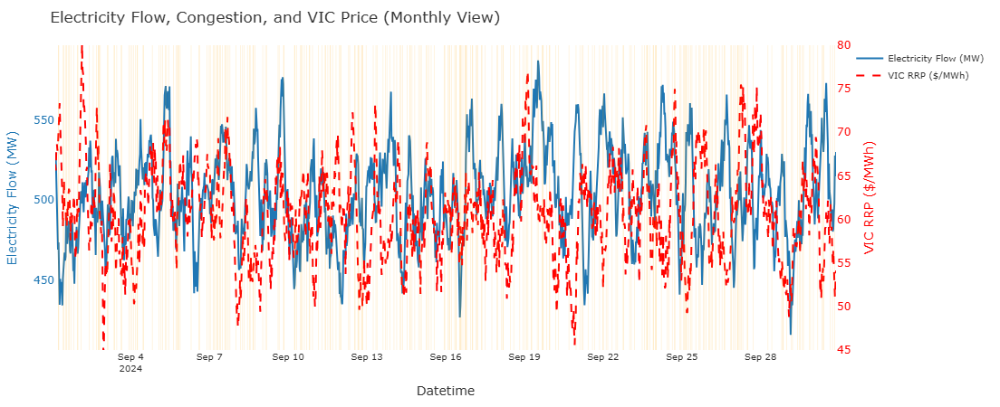

In [107]:
# 4.9 Simulated Visualization: Electricity Flow, Congestion, and NSW Price

# Simulates VIC data
np.random.seed(42)  #Set seed for reproducibility

# Creates a 30-minute interval date range for the month of September 2024
range_date = pd.date_range(start="2024-09-01", end="2024-09-30 23:30", freq="30min")

# Generates simulated VIC data: electricity flow, RRP, and congestion status
df_vic_combined = pd.DataFrame({
    'MWFLOW': np.random.normal(loc=500, scale=100, size=len(range_date)),  # Simulated electricity flow (MW)
    'VIC_RRP': np.random.normal(loc=60, scale=20, size=len(range_date)),   # Simulated VIC RRP ($/MWh)
    'CONGESTED': np.random.choice([True, False], size=len(range_date), p=[0.2, 0.8])  # 20% chance of congestion
}, index=range_date)  # Set datetime as index

# Smoothing the simulated values using a rolling window 
df_vic_combined['MWFLOW_SMOOTH'] = df_vic_combined['MWFLOW'].rolling(window=12, center=True).mean()  #Smooth flow (6 hours)
df_vic_combined['RRP_SMOOTH'] = df_vic_combined['VIC_RRP'].rolling(window=12, center=True).mean()    #Smooth RRP
df_vic_combined.dropna(inplace=True)  # Drop rows with NaNs caused by rolling

# Identifies congestion periods to visually highlight in the plot 
congestion_bands = []  # List to hold (start, end) of congestion intervals
in_congestion = False  # Track whether currently inside a congestion period

# Looping over all time intervals to extract congestion bands
for i in range(len(df_vic_combined)):
    if df_vic_combined['CONGESTED'].iloc[i] and not in_congestion:
        start = df_vic_combined.index[i]  
        in_congestion = True
    elif not df_vic_combined['CONGESTED'].iloc[i] and in_congestion:
        end = df_vic_combined.index[i]  
        congestion_bands.append((start, end)) 
        in_congestion = False

# If still in congestion at the end of the data, close the last band
if in_congestion:
    congestion_bands.append((start, df_vic_combined.index[-1]))

# Begins plot creation
fig = go.Figure()

# Adding shaded vertical rectangles for each congestion band
for start, end in congestion_bands:
    fig.add_vrect(x0=start, x1=end, fillcolor='orange', opacity=0.2, line_width=0)  

# Adding smoothed electricity flow line (left Y-axis)
fig.add_trace(go.Scatter(
    x=df_vic_combined.index,
    y=df_vic_combined['MWFLOW_SMOOTH'],
    name='Electricity Flow (MW)',
    line=dict(color='#1f77b4'),  
    hovertemplate='Time: %{x}<br>Flow: %{y:.1f} MW<extra></extra>',
    yaxis='y1'
))

# Adding smoothed VIC RRP line (right Y-axis)
fig.add_trace(go.Scatter(
    x=df_vic_combined.index,
    y=df_vic_combined['RRP_SMOOTH'],
    name='VIC RRP ($/MWh)',
    line=dict(color='red', dash='dash'),  
    hovertemplate='Time: %{x}<br>RRP: %{y:.1f} $/MWh<extra></extra>',
    yaxis='y2'
))

# Customizing layout 
fig.update_layout(
    title='Electricity Flow, Congestion, and VIC Price (Monthly View)',  
    xaxis=dict(title='Datetime', tickfont=dict(size=10)), 
    yaxis=dict(  
        title='Electricity Flow (MW)',
        titlefont=dict(color='#1f77b4'),
        tickfont=dict(color='#1f77b4')
    ),
    yaxis2=dict(  
        title='VIC RRP ($/MWh)',  
        overlaying='y',
        side='right',
        titlefont=dict(color='red'),
        tickfont=dict(color='red'),
        range=[45, 80]  
    ),
    legend=dict(font=dict(size=10)),  # Legend styling
    font=dict(color='#333333'),  # Overall font color
    hovermode='x unified',  # Show hover across all traces
    plot_bgcolor='white',  # Background color
    height=450,  # Chart height
    margin=dict(t=50, b=40, l=60, r=30)  # Padding around the plot
)

# Shows interactive plot
fig.show()


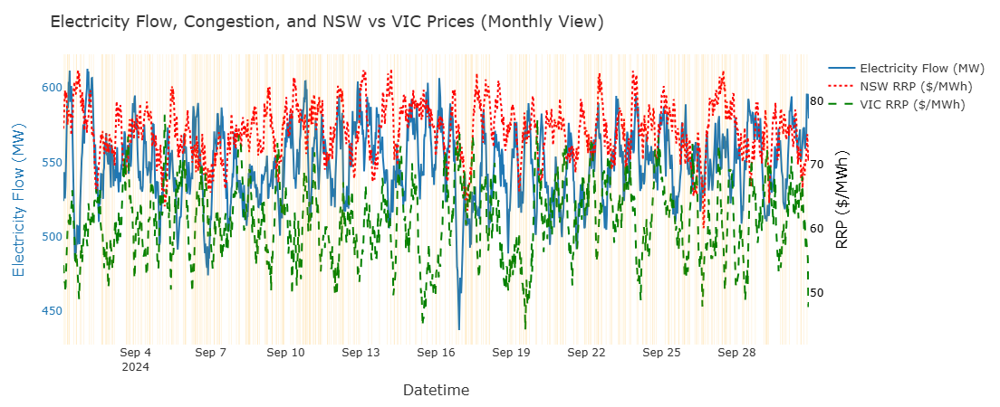

In [109]:
# 4.10 Simulates NSW & VIC electricity data 
np.random.seed(123)  # For reproducibility of random values

# Generates 30-min interval timestamps for September 2024
range_date = pd.date_range(start="2024-09-01", end="2024-09-30 23:30", freq="30min")

# Creates a DataFrame with simulated data
df_both_combined = pd.DataFrame({
    'MWFLOW': np.random.normal(loc=550, scale=90, size=len(range_date)),  # Electricity flow (MW)
    'NSW_RRP': np.random.normal(loc=75, scale=15, size=len(range_date)),  # NSW spot price (RRP)
    'VIC_RRP': np.random.normal(loc=60, scale=20, size=len(range_date)),  # VIC spot price (RRP)
    'CONGESTED': np.random.choice([True, False], size=len(range_date), p=[0.25, 0.75])  # 25% chance congestion
}, index=range_date)

# --- Smoothing the data using a rolling window (6 hours = 12 half-hour points) ---
df_both_combined['MWFLOW_SMOOTH'] = df_both_combined['MWFLOW'].rolling(window=12, center=True).mean()
df_both_combined['NSW_RRP_SMOOTH'] = df_both_combined['NSW_RRP'].rolling(window=12, center=True).mean()
df_both_combined['VIC_RRP_SMOOTH'] = df_both_combined['VIC_RRP'].rolling(window=12, center=True).mean()

# Removing rows with NaNs from smoothing
df_both_combined.dropna(inplace=True)

# --- Identifies start and end of congestion periods ---
congestion_bands = []   # List to hold congestion intervals
in_congestion = False   # Flag to track if we're in a congested period

# Iterating through the time series to capture intervals where congestion = True
for i in range(len(df_both_combined)):
    if df_both_combined['CONGESTED'].iloc[i] and not in_congestion:
        start = df_both_combined.index[i]  # Mark start of congestion
        in_congestion = True
    elif not df_both_combined['CONGESTED'].iloc[i] and in_congestion:
        end = df_both_combined.index[i]    # Mark end of congestion
        congestion_bands.append((start, end))
        in_congestion = False

# If congestion lasts till the end, close the last interval
if in_congestion:
    congestion_bands.append((start, df_combined_both.index[-1]))

# --- Creating the interactive plot ---
fig = go.Figure()

# Adding vertical shaded areas for each congestion band
for start, end in congestion_bands:
    fig.add_vrect(x0=start, x1=end, fillcolor='orange', opacity=0.2, line_width=0)

# Adding smoothed electricity flow line (left Y-axis)
fig.add_trace(go.Scatter(
    x=df_both_combined.index,
    y=df_both_combined['MWFLOW_SMOOTH'],
    name='Electricity Flow (MW)',
    line=dict(color='#1f77b4'),  # Blue
    hovertemplate='Time: %{x}<br>Flow: %{y:.1f} MW<extra></extra>',
    yaxis='y1'
))

# Adding smoothed NSW RRP line (right Y-axis)
fig.add_trace(go.Scatter(
    x=df_both_combined.index,
    y=df_both_combined['NSW_RRP_SMOOTH'],
    name='NSW RRP ($/MWh)',
    line=dict(color='red', dash='dot'),  
    hovertemplate='Time: %{x}<br>NSW RRP: %{y:.1f} $/MWh<extra></extra>',
    yaxis='y2'
))

# Adding smoothed VIC RRP line (right Y-axis)
fig.add_trace(go.Scatter(
    x=df_both_combined.index,
    y=df_both_combined['VIC_RRP_SMOOTH'],
    name='VIC RRP ($/MWh)',
    line=dict(color='green', dash='dash'),  
    hovertemplate='Time: %{x}<br>VIC RRP: %{y:.1f} $/MWh<extra></extra>',
    yaxis='y2'
))

# Customizing layout 
fig.update_layout(
    title=dict(
        text='Electricity Flow, Congestion, and NSW vs VIC Prices (Monthly View)',  
        font=dict(size=18, color='#333333')
    ),
    xaxis=dict(
        title='Datetime',
        titlefont=dict(size=16, color='#333333'),
        tickfont=dict(size=12, color='#333333')
    ),
    yaxis=dict(
        title='Electricity Flow (MW)',  
        titlefont=dict(size=16, color='#1f77b4'),
        tickfont=dict(size=12, color='#1f77b4')
    ),
    yaxis2=dict(
        title='RRP ($/MWh)',  
        overlaying='y',  
        side='right',
        titlefont=dict(size=16, color='black'),
        tickfont=dict(size=12, color='black')
    ),
    legend=dict(
        font=dict(size=13, color='#333333'),
        title_font=dict(size=14, color='#333333')
    ),
    font=dict(color='#333333'),  
    hovermode='x unified',      
    plot_bgcolor='white',       
    height=450,
    margin=dict(t=60, b=50, l=70, r=70)  
)

# Displays the plot
fig.show()


In [ ]:
# PREDICTIVE MODEL 

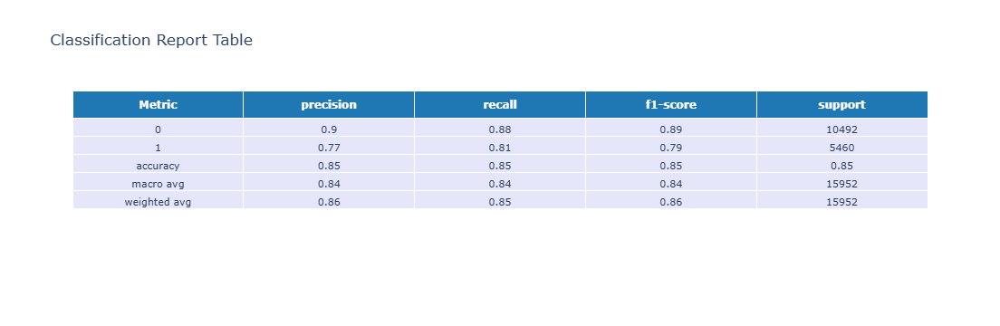

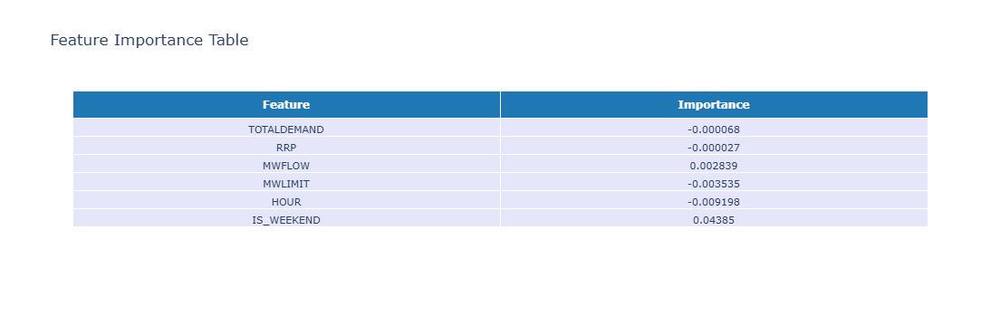

In [111]:
import pandas as pd
import plotly.graph_objects as go
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

# Ensuring required columns exist in merged dataset

# Joins it from df_nsw_price on SETTLEMENTDATE (If RRP column is missing)
if 'RRP' not in merged.columns:
    merged = merged.join(df_nsw_price[['RRP']], on='SETTLEMENTDATE', how='left')

# Extracting hour from SETTLEMENTDATE(If HOUR column is missing)
if 'HOUR' not in merged.columns:
    merged['HOUR'] = merged.index.hour if merged.index.name == 'SETTLEMENTDATE' else pd.to_datetime(merged['SETTLEMENTDATE']).dt.hour

# Checking if each date falls on a weekend(If IS_WEEKEND column is missing)
if 'IS_WEEKEND' not in merged.columns:
    merged['IS_WEEKEND'] = merged.index.dayofweek >= 5 if merged.index.name == 'SETTLEMENTDATE' else pd.to_datetime(merged['SETTLEMENTDATE']).dt.dayofweek >= 5

# Ensures MWFLOW & MWLIMIT are present in merged
if 'MWFLOW' not in merged.columns or 'MWLIMIT' not in merged.columns:
    merged = merged.join(df_interconnector_vic_nsw[['MWFLOW', 'MWLIMIT']], on='SETTLEMENTDATE', how='left')

# Defining model input and target variable

# List of predictor feature columns
features = ['TOTALDEMAND', 'RRP', 'MWFLOW', 'MWLIMIT', 'HOUR', 'IS_WEEKEND']

# Filters only necessary columns and droping rows with missing values
df_model = merged[features + ['CONGESTED']].dropna()

# Defining feature matrix X and target vector y
X = df_model[features]
y = df_model['CONGESTED'].astype(int)  # Convert boolean to integer (0 or 1)

# Training logistic regression model
# Spliting data into training and test sets (70% train, 30% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Creating logistic regression model and fit it
reg_model = LogisticRegression(max_iter=1000)  # Increase max_iter to ensure convergence
reg_model.fit(X_train, y_train)

# Predicting on test set
y_pred = reg_model.predict(X_test)

# Generating classification report and convert to DataFrame

# Gets precision, recall, f1-score, and support for each class
report = classification_report(y_test, y_pred, output_dict=True)

# Converts to DataFrame, round values, and reset index
df_report = pd.DataFrame(report).transpose().round(2).reset_index().rename(columns={"index": "Metric"})

# Extracts feature importance (model coefficients)

# Gets logistic regression coefficients for each feature
coefficients = pd.Series(reg_model.coef_[0], index=features).round(6).reset_index()
coefficients.columns = ['Feature', 'Importance']  # Rename columns for clarity

# Plotting classification report table using Plotly

fig1 = go.Figure(data=[go.Table(
    header=dict(
        values=["<b>" + col + "</b>" for col in df_report.columns],  # Bold column headers
        fill_color='#1f77b4',  # Blue header background
        font=dict(color='white', size=12),
        align='center'
    ),
    cells=dict(
        values=[df_report[col] for col in df_report.columns],  # Fill each column's values
        fill_color='lavender',
        font=dict(size=11),
        align='center'
    )
)])
fig1.update_layout(title='Classification Report Table')  # Adding plot title
fig1.show()

# Plotting feature importance table using Plotly

fig2 = go.Figure(data=[go.Table(
    header=dict(
        values=["<b>Feature</b>", "<b>Importance</b>"],  # Defining headers
        fill_color='#1f77b4',
        font=dict(color='white', size=12),
        align='center'
    ),
    cells=dict(
        values=[coefficients['Feature'], coefficients['Importance']],  # Populate table with feature names and their weights
        fill_color='lavender',
        font=dict(size=11),
        align='center'
    )
)])
fig2.update_layout(title='Feature Importance Table')  # Adding plot title
fig2.show()


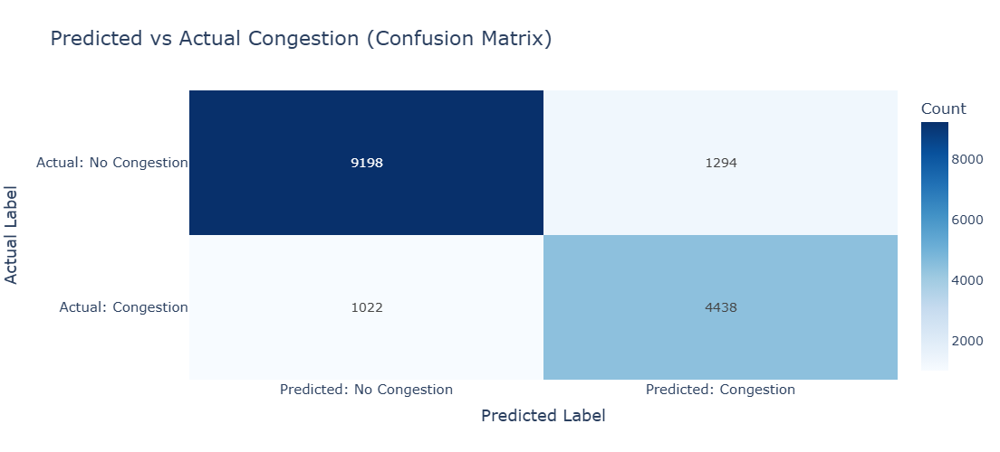

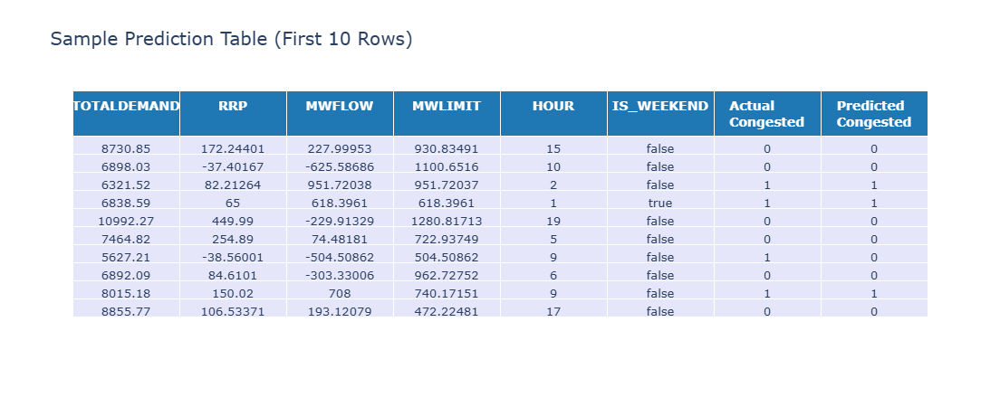

In [113]:
import plotly.graph_objects as go
from sklearn.metrics import confusion_matrix
import pandas as pd

# 1. Functions to plot confusion matrix using Plotly 
def plot_confusion_matrix_plotly(y_true, y_pred):
    # Computing confusion matrix from actual and predicted labels
    conf_matrix = confusion_matrix(y_true, y_pred)

    # Defining class labels
    labels = ['No Congestion', 'Congestion']

    # Converting numeric matrix to string format for annotation
    text = [[str(val) for val in row] for row in conf_matrix]

    # Creating heatmap using Plotly
    fig = go.Figure(data=go.Heatmap(
        z=conf_matrix,  # Matrix values (color intensity)
        x=[f"Predicted: {label}" for label in labels],  # Column labels
        y=[f"Actual: {label}" for label in labels],  # Row labels
        text=text,  # Annotated values
        texttemplate="%{text}",  # Format text in heatmap
        colorscale='Blues',  # Color theme
        colorbar=dict(title='Count')  # Colorbar label
    ))

    # Customizing layout of the heatmap
    fig.update_layout(
        title="Predicted vs Actual Congestion (Confusion Matrix)",
        title_font=dict(size=22),  
        xaxis_title="Predicted Label",
        yaxis_title="Actual Label",
        xaxis=dict(
            tickfont=dict(size=15),   
            title_font=dict(size=18)  
        ),
        yaxis=dict(
            tickfont=dict(size=15),  
            title_font=dict(size=18),  
            autorange='reversed'  # Reversing y-axis to match matrix convention
        ),
        font=dict(size=14),  # Base font size
        width=700,  # Figure width
        height=500  # Figure height
    )

    fig.show()  # Displays the plot

# 2. Function to show sample prediction table using Plotly 
def show_sample_predictions_plotly(X_test, y_test, y_pred, n=10):
    # Selects first n rows from test data
    table = X_test.copy().iloc[:n]

    # Adds actual target values
    table['Actual Congested'] = y_test.iloc[:n].values

    # Adds model's predicted values
    table['Predicted Congested'] = y_pred[:n]

    # Creating a Plotly table
    fig = go.Figure(data=[go.Table(
        header=dict(
            values=['<b>' + col + '</b>' for col in table.columns],  
            fill_color='#1f77b4',  
            font=dict(color='white', size=14),  
            align='center'
        ),
        cells=dict(
            values=[table[col] for col in table.columns],  
            fill_color='lavender',  
            align='center',
            font=dict(size=13)  
        )
    )])

    # Customize layout
    fig.update_layout(
        title='Sample Prediction Table (First 10 Rows)',
        title_font=dict(size=20), 
        height=450  
    )

    fig.show()  # Displays the table

# Calls both functions to display results
plot_confusion_matrix_plotly(y_test, y_pred)
show_sample_predictions_plotly(X_test, y_test, y_pred)
